### DS 5220: Supervised Machine Learning and Learning Theory I

### Music Analysis using Machine Learning (Team 1)

#### Spotify Features Dataset

Surya Menon's Code - Song Popularity Classification


#### Loading Data
Initially loading the dataset, looking at size, variables, missing data

In [2]:
# import packages
import os
import time
import random 
import statistics
import pandas as pd
import numpy as np 
from pprint import pprint
from numpy.linalg import pinv
%matplotlib notebook
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split 
from sklearn.feature_selection import mutual_info_classif, f_classif, chi2

In [3]:
# load data
path = os.getcwd()+'/data/SpotifyFeatures.csv'
music = pd.read_csv(path)

# look at shape
print(music.shape)
music.head()

(232725, 18)


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.611,0.389,99373,0.910,0.000,C#,0.3460,-1.828,Major,0.0525,166.969,4/4,0.814
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.246,0.590,137373,0.737,0.000,F#,0.1510,-5.559,Minor,0.0868,174.003,4/4,0.816
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.952,0.663,170267,0.131,0.000,C,0.1030,-13.879,Minor,0.0362,99.488,5/4,0.368
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.703,0.240,152427,0.326,0.000,C#,0.0985,-12.178,Major,0.0395,171.758,4/4,0.227
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.950,0.331,82625,0.225,0.123,F,0.2020,-21.150,Major,0.0456,140.576,4/4,0.390


In [3]:
music.columns

Index(['genre', 'artist_name', 'track_name', 'track_id', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence'],
      dtype='object')

In [4]:
# look for explict null values in dataframe
pd.isna(music).sum()

genre               0
artist_name         0
track_name          0
track_id            0
popularity          0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
speechiness         0
tempo               0
time_signature      0
valence             0
dtype: int64

### Exploratory Data Analysis (EDA)

Conduct EDA to get better understanding of dataset and variables of interest. Focused on popularity measure and some general visualization

In [5]:
# basic statistics
music.describe()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,232725.000000,232725.000000,232725.000000,2.327250e+05,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000,232725.000000
mean,41.127502,0.368560,0.554364,2.351223e+05,0.570958,0.148301,0.215009,-9.569885,0.120765,117.666585,0.454917
std,18.189948,0.354768,0.185608,1.189359e+05,0.263456,0.302768,0.198273,5.998204,0.185518,30.898907,0.260065
min,0.000000,0.000000,0.056900,1.538700e+04,0.000020,0.000000,0.009670,-52.457000,0.022200,30.379000,0.000000
25%,29.000000,0.037600,0.435000,1.828570e+05,0.385000,0.000000,0.097400,-11.771000,0.036700,92.959000,0.237000
50%,43.000000,0.232000,0.571000,2.204270e+05,0.605000,0.000044,0.128000,-7.762000,0.050100,115.778000,0.444000
75%,55.000000,0.722000,0.692000,2.657680e+05,0.787000,0.035800,0.264000,-5.501000,0.105000,139.054000,0.660000
max,100.000000,0.996000,0.989000,5.552917e+06,0.999000,0.999000,1.000000,3.744000,0.967000,242.903000,1.000000


In [3]:
# find top 10 popular songs in dataset
music.nlargest(10,'popularity')[['track_name', 'artist_name', 'popularity', 'genre']]

,track_name,artist_name,popularity,genre
9027,7 rings,Ariana Grande,100,Dance
107804,7 rings,Ariana Grande,100,Pop
9026,"break up with your girlfriend, i'm bored",Ariana Grande,99,Dance
86951,Wow.,Post Malone,99,Rap
107802,"break up with your girlfriend, i'm bored",Ariana Grande,99,Pop
107803,Wow.,Post Malone,99,Pop
66643,Con Calma,Daddy Yankee,98,Hip-Hop
107909,Con Calma,Daddy Yankee,98,Pop
138918,Con Calma,Daddy Yankee,98,Reggaeton
9028,Without Me,Halsey,97,Dance


In [5]:
# get specific artist results
music.loc[music['artist_name'] == 'Drake']

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
66624,Hip-Hop,Drake,God's Plan,6DCZcSspjsKoFjzjrWoCdn,89,0.033200,0.754,198973,0.449,0.000083,G,0.5520,-9.211,Major,0.1090,77.169,4/4,0.3570
66631,Hip-Hop,Drake,In My Feelings,2G7V7zsVDxg1yRsu7Ew9RJ,88,0.058900,0.835,217925,0.626,0.000060,C#,0.3960,-5.833,Major,0.1250,91.030,4/4,0.3500
66635,Hip-Hop,Drake,Nice For What,3CA9pLiwRIGtUBiMjbZmRw,86,0.089100,0.586,210747,0.909,0.000109,G#,0.1190,-6.474,Major,0.0705,93.394,4/4,0.7570
66695,Hip-Hop,Drake,Mob Ties,7rC5Pl8rQSX4myONQHYPBK,80,0.045600,0.755,205147,0.575,0.001240,E,0.2760,-8.393,Minor,0.0678,85.987,4/4,0.4900
66698,Hip-Hop,Drake,Passionfruit,5mCPDVBb16L4XQwDdbRUpz,82,0.304000,0.804,298941,0.459,0.086200,B,0.1100,-11.556,Major,0.0390,111.963,4/4,0.3720
66704,Hip-Hop,Drake,I'm Upset,3qN5qMTKyEEmiTZD38BNTT,79,0.279000,0.899,214467,0.586,0.000000,B,0.0836,-7.866,Minor,0.3440,150.001,4/4,0.4920
66716,Hip-Hop,Drake,Don’t Matter To Me (with Michael Jackson),6G8kHiVZ1jW7vHMPVRNZU0,82,0.493000,0.826,245787,0.318,0.013100,A#,0.1100,-12.391,Major,0.0574,103.002,4/4,0.1380
66776,Hip-Hop,Drake,One Dance,1zi7xx7UVEFkmKfv06H8x0,83,0.008420,0.796,173987,0.610,0.002860,C#,0.3510,-5.857,Major,0.0516,103.990,4/4,0.3910
66789,Hip-Hop,Drake,Jumpman,27GmP9AWRs744SzKcpJsTZ,77,0.056300,0.852,205879,0.553,0.000000,C#,0.3320,-7.286,Major,0.1870,142.072,4/4,0.6560
66801,Hip-Hop,Drake,The Motto,4Kz4RdRCceaA9VgTqBhBfa,75,0.000107,0.766,181573,0.442,0.000061,C#,0.1110,-8.558,Major,0.3560,201.800,4/4,0.3900


In [6]:
# get specific artist results
music.loc[music['artist_name'] == 'Ed Sheeran']

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
107888,Pop,Ed Sheeran,Perfect,0tgVpDi06FyKpA1z0VMD4v,89,0.16300,0.599,263400,0.4480,0.000000,G#,0.1060,-6.312,Major,0.0232,95.050,3/4,0.168
107952,Pop,Ed Sheeran,Happier,2RttW7RAu5nOAfq6YFvApB,86,0.53600,0.522,207520,0.3850,0.000000,C,0.1350,-7.355,Major,0.0288,89.792,4/4,0.236
107999,Pop,Ed Sheeran,Shape of You,7qiZfU4dY1lWllzX7mPBI3,87,0.58100,0.825,233713,0.6520,0.000000,C#,0.0931,-3.183,Minor,0.0802,95.977,4/4,0.931
108090,Pop,Ed Sheeran,Thinking Out Loud,34gCuhDGsG4bRPIf9bb02f,85,0.47400,0.781,281560,0.4450,0.000000,D,0.1840,-6.061,Major,0.0295,78.998,4/4,0.591
108182,Pop,Ed Sheeran,Photograph,1HNkqx9Ahdgi1Ixy2xkKkL,86,0.60700,0.614,258987,0.3790,0.000464,E,0.0986,-10.480,Major,0.0476,107.989,4/4,0.201
108205,Pop,Ed Sheeran,Galway Girl,0afhq8XCExXpqazXczTSve,83,0.07350,0.624,170827,0.8760,0.000000,A,0.3270,-3.374,Major,0.1000,99.943,4/4,0.781
108218,Pop,Ed Sheeran,Castle on the Hill,6PCUP3dWmTjcTtXY02oFdT,82,0.02320,0.461,261154,0.8340,0.000011,D,0.1400,-4.868,Major,0.0989,135.007,4/4,0.471
108227,Pop,Ed Sheeran,Perfect Duet (Ed Sheeran & Beyoncé),1bhUWB0zJMIKr9yVPrkEuI,83,0.77900,0.587,259550,0.2990,0.000000,G#,0.1230,-7.365,Major,0.0263,94.992,3/4,0.356
108403,Pop,Ed Sheeran,Dive,51ChrwmUPDJvedPQnIU8Ls,80,0.35500,0.761,238440,0.3860,0.000000,E,0.0953,-6.158,Major,0.0399,134.943,3/4,0.526
108473,Pop,Ed Sheeran,Supermarket Flowers,4VuS959DSpr82t3qBqCrWG,80,0.91400,0.589,221107,0.2420,0.000000,F#,0.0887,-10.517,Major,0.0442,89.749,4/4,0.257


In [9]:
# top 5 artists by song counts
music.groupby('artist_name')['artist_name'].count().nlargest(5)

artist_name
Giuseppe Verdi            1394
Giacomo Puccini           1137
Kimbo Children's Music     971
Nobuo Uematsu              825
Richard Wagner             804
Name: artist_name, dtype: int64

In [7]:
# top 10 average song popularity of artists
music.groupby('artist_name')['popularity'].mean().nlargest(10)

artist_name
Pedro Capó              87.000000
Mario Bautista          85.000000
Mau y Ricky             83.000000
Kris Kross Amsterdam    82.000000
Ninho                   82.000000
Paloma Mami             82.000000
Martin Garrix           81.857143
Sofia Reyes             81.500000
Anitta                  81.000000
Heuss L'enfoiré         81.000000
Name: popularity, dtype: float64

<IPython.core.display.Javascript object>


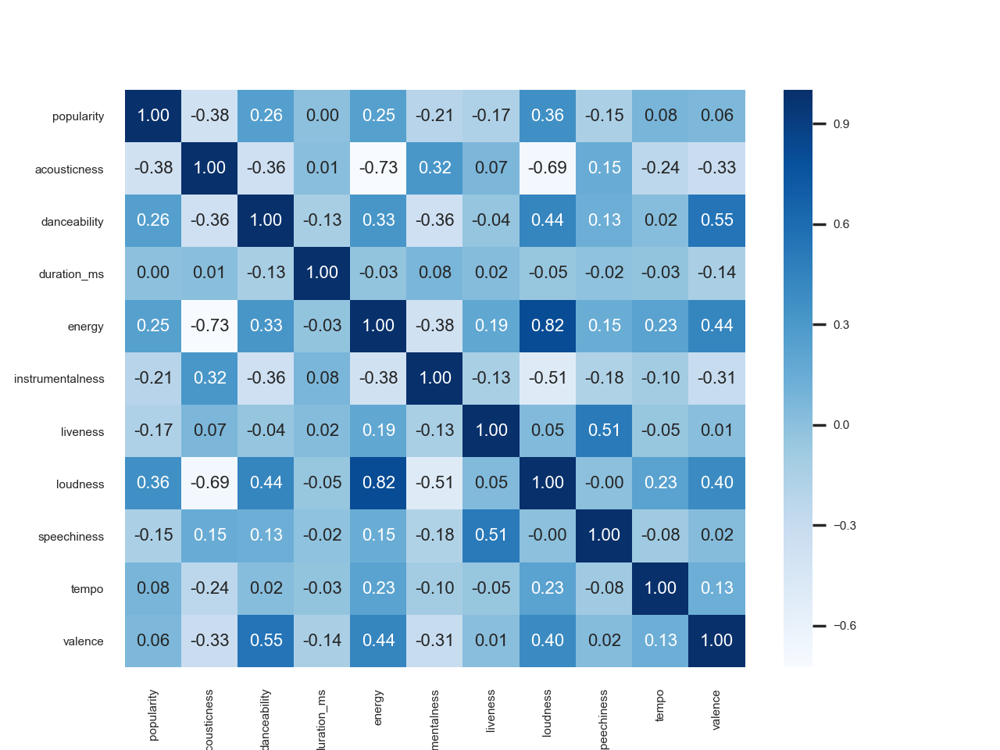

In [4]:
# correlation values
sns.set(font_scale=0.5)
corr = music.corr()
sns.heatmap(corr, fmt='.2f', annot=True, annot_kws={"fontsize":8}, cmap="Blues")
plt.show()

<IPython.core.display.Javascript object>


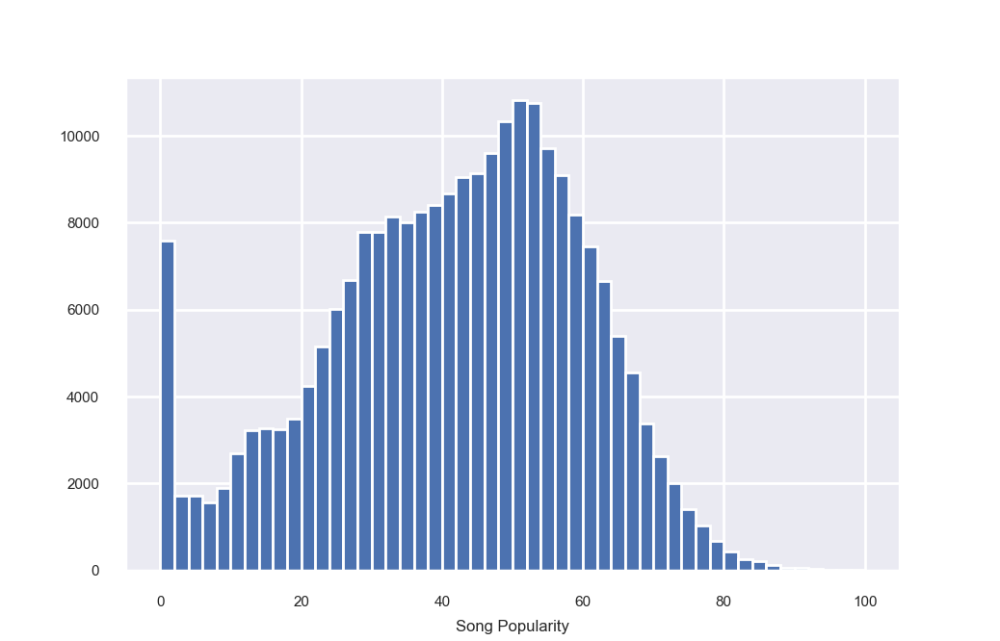

In [4]:
# distribution of popularity
music['popularity'].hist(bins=50)
plt.xlabel('Song Popularity')
plt.show()

In [20]:
# sort by correlation value
corr.reindex(corr.popularity.abs().
             sort_values(ascending=False).index)['popularity']

popularity          1.000000
acousticness       -0.381295
loudness            0.363011
danceability        0.256564
energy              0.248922
instrumentalness   -0.210983
liveness           -0.167995
speechiness        -0.151076
tempo               0.081039
valence             0.060076
duration_ms         0.002348
Name: popularity, dtype: float64

<IPython.core.display.Javascript object>


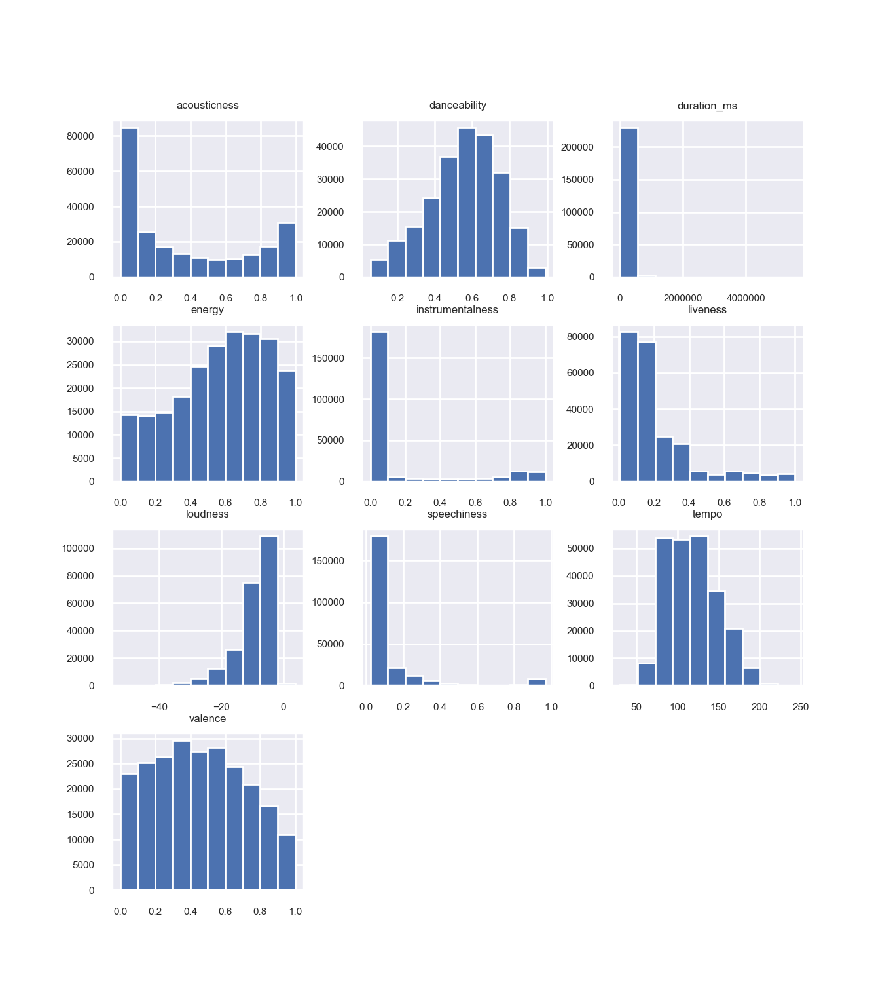

In [10]:
# plot other continuous measures
music[['acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence']].hist()
plt.show()

<IPython.core.display.Javascript object>


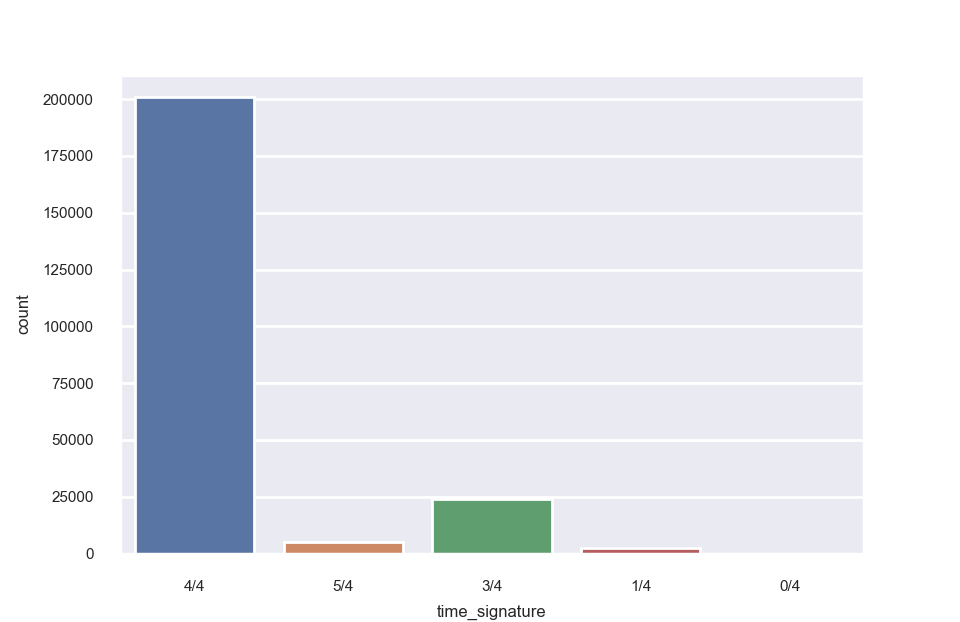

In [5]:
# look at categorical measures counts
sns.countplot(x='time_signature',data=music)
plt.show()

<IPython.core.display.Javascript object>


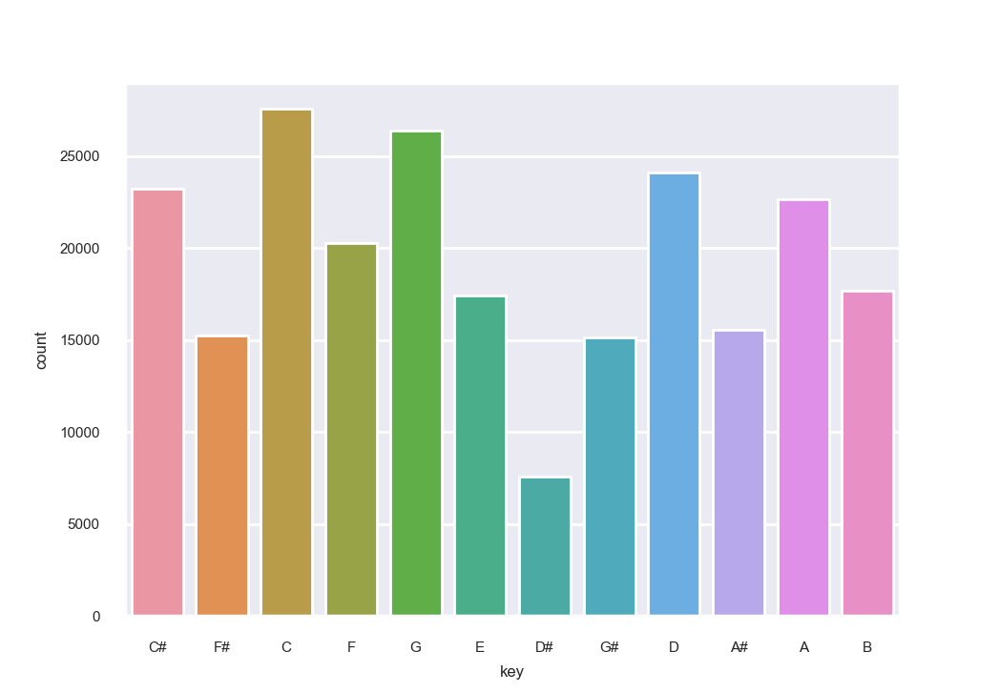

In [6]:
sns.countplot(x='key',data=music)
plt.show()

<IPython.core.display.Javascript object>


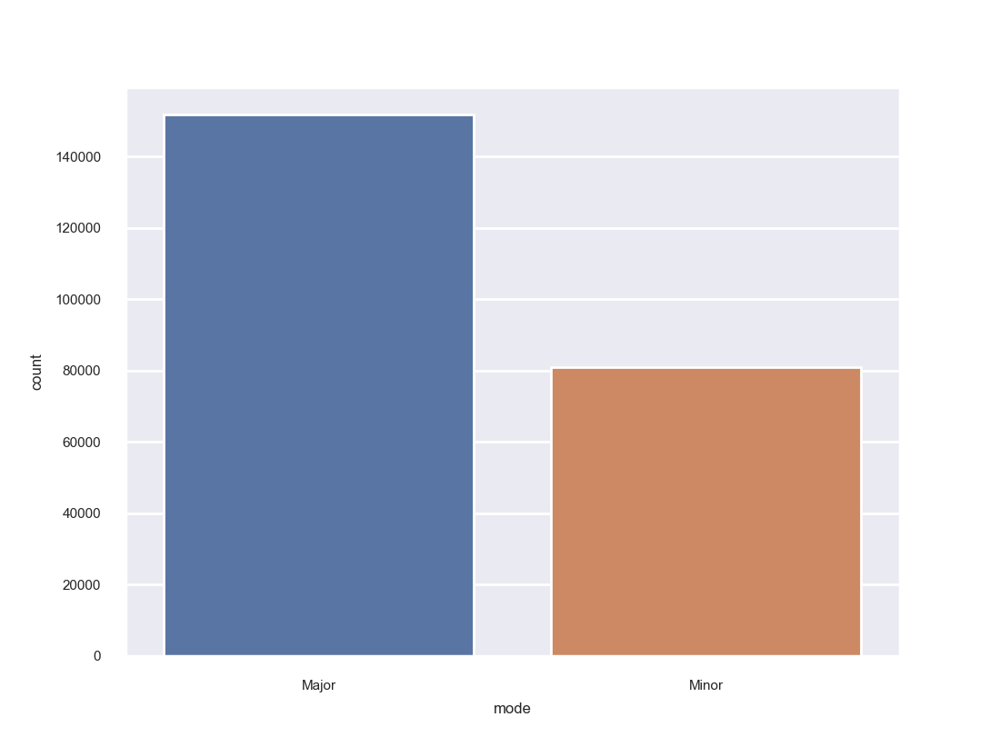

In [7]:
sns.countplot(x='mode',data=music)
plt.show()

In [13]:
# unique genres
music['genre'].nunique()

26

In [17]:
music['genre'].value_counts()

Comedy              9681
Soundtrack          9646
Indie               9543
Jazz                9441
Pop                 9386
Electronic          9377
Children’s Music    9353
Folk                9299
Hip-Hop             9295
Rock                9272
Alternative         9263
Classical           9256
Rap                 9232
World               9096
Soul                9089
Blues               9023
R&B                 8992
Anime               8936
Reggaeton           8927
Ska                 8874
Reggae              8771
Dance               8701
Country             8664
Opera               8280
Movie               7806
Children's Music    5403
A Capella            119
Name: genre, dtype: int64

<IPython.core.display.Javascript object>


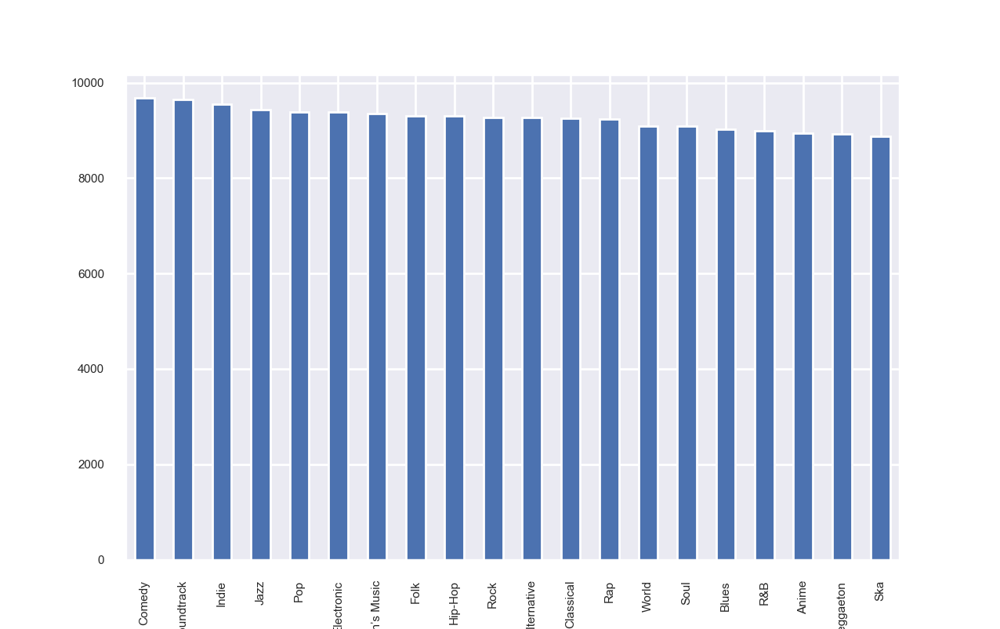

In [8]:
# top 20 genres
music['genre'].value_counts().head(20).plot('bar')
plt.show()

In [132]:
music.loc[music['genre'].str.contains('Children', case=False), 'genre'] = 'Children\'s Music'

<IPython.core.display.Javascript object>


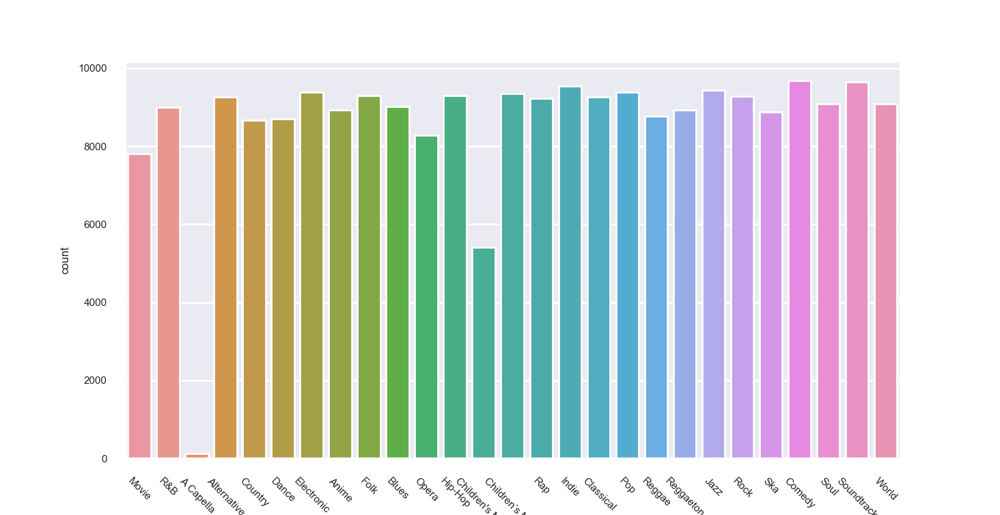

In [22]:
sns.countplot(x='genre',data=music)
plt.xticks(rotation=-45)
plt.show()

<IPython.core.display.Javascript object>


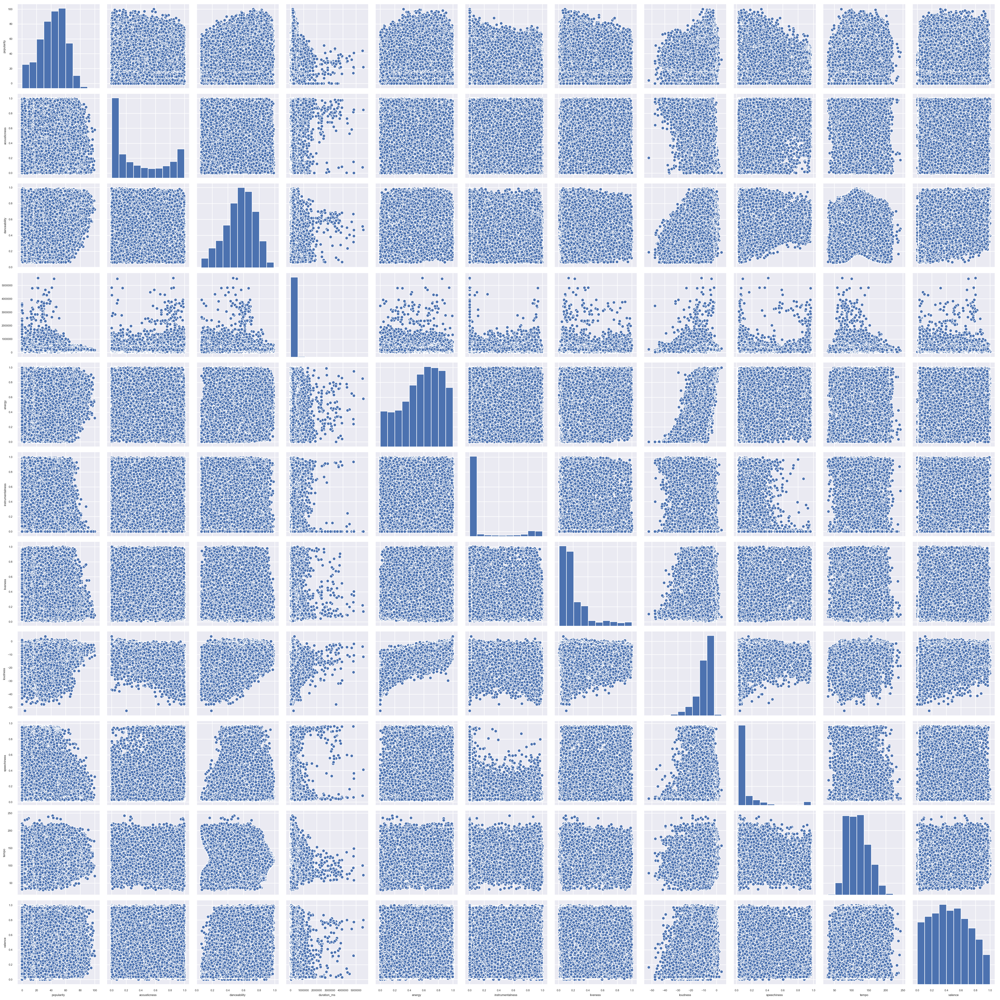

In [6]:
# plot scatterplots on all continuous measures (takes a while to run and load)
sns.pairplot(music)
plt.show()

<IPython.core.display.Javascript object>


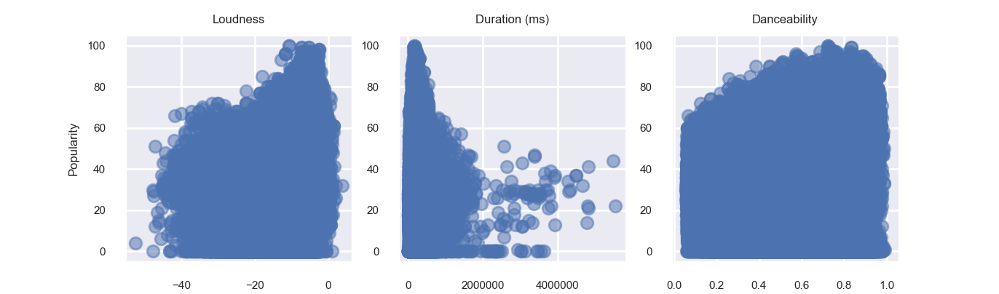

In [10]:
# explore scatterplots further - look against popularity 
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
ax1.scatter(music['loudness'], music['popularity'], alpha=0.5)
#ax1.set_xlabel('Loudness')
ax1.set_title('Loudness')
ax1.set_ylabel('Popularity')
ax2.scatter(music['duration_ms'], music['popularity'], alpha=0.5)
#ax2.set_xlabel('Duration (ms)')
ax2.set_title('Duration (ms)')
ax3.scatter(music['danceability'], music['popularity'], alpha=0.5)
#ax3.set_xlabel('Danceability')
ax3.set_title('Danceability')
plt.show()

<IPython.core.display.Javascript object>


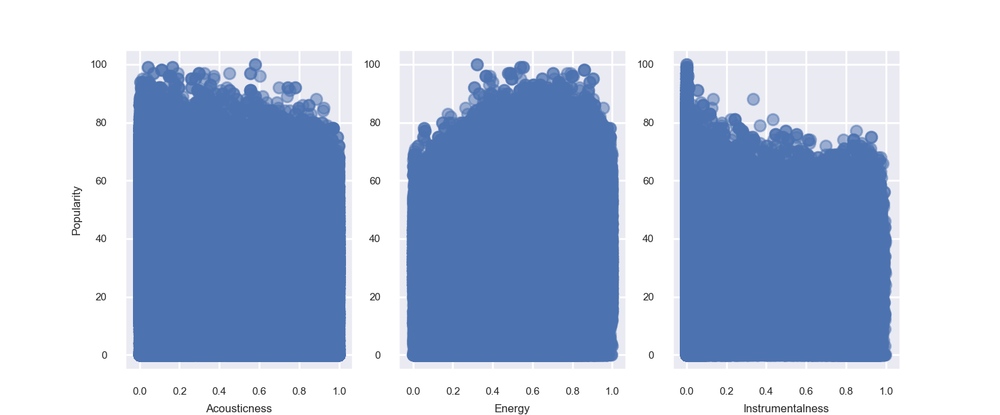

In [14]:
# look at more continuous metrics against popularity 
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
ax1.scatter(music['acousticness'], music['popularity'], alpha=0.5)
ax1.set_xlabel('Acousticness')
ax1.set_ylabel('Popularity')
ax2.scatter(music['energy'], music['popularity'], alpha=0.5)
ax2.set_xlabel('Energy')
ax3.scatter(music['instrumentalness'], music['popularity'], alpha=0.5)
ax3.set_xlabel('Instrumentalness')
plt.show()

<IPython.core.display.Javascript object>


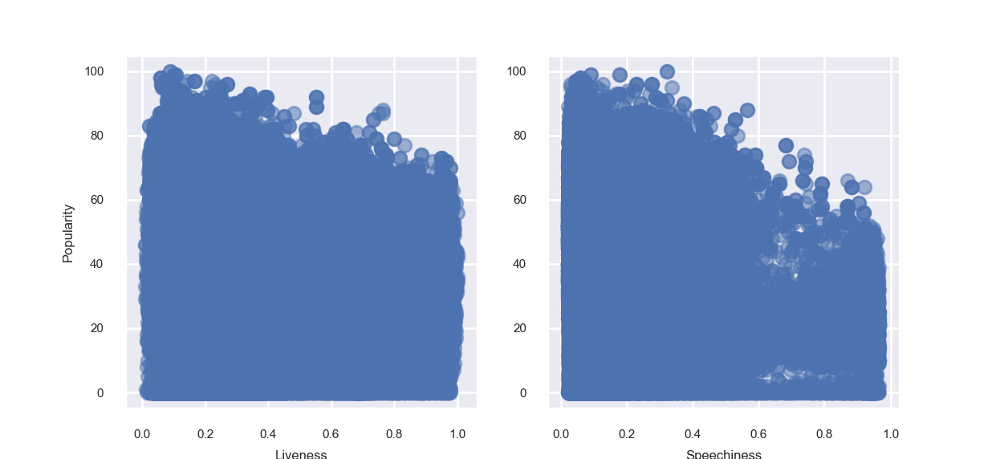

In [15]:
# popularity versus speechiness
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.scatter(music['liveness'], music['popularity'], alpha=0.5)
ax1.set_xlabel('Liveness')
ax1.set_ylabel('Popularity')
ax2.scatter(music['speechiness'], music['popularity'], alpha=0.5)
ax2.set_xlabel('Speechiness')
plt.show()

<IPython.core.display.Javascript object>


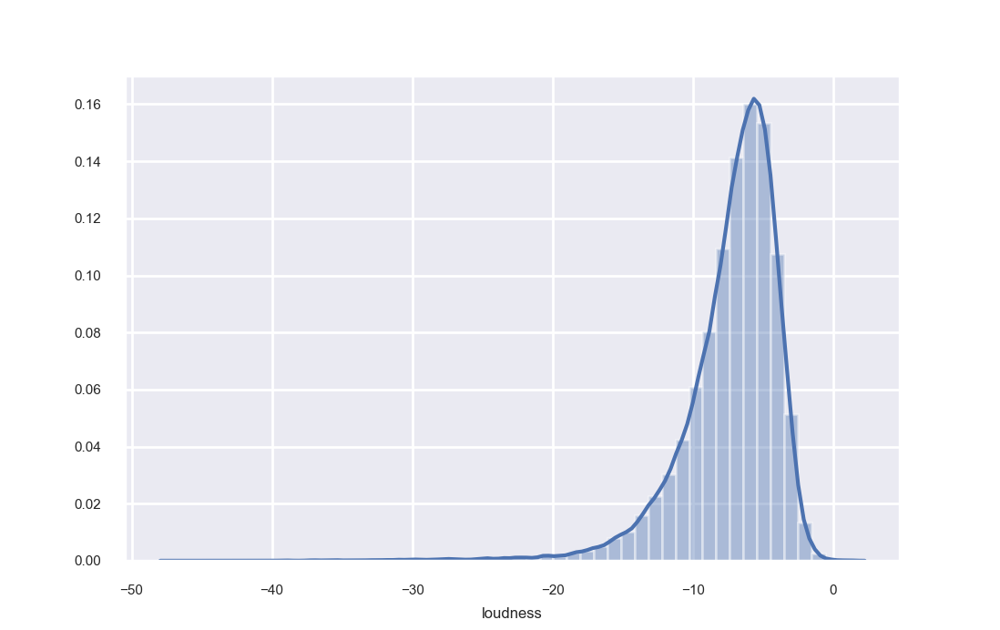

In [12]:
# look at loudness of popular songs (using 50 as metric)
sns.distplot(music[music.popularity > 50]['loudness'])
plt.show()

In [8]:
# create binary measure for popularity - play around with different thresholds 
# use 50 as cutoff 
#music['popular_bin'] = np.where(music['popularity']>=50, 1, 0)
music['popular_bin'] = np.where(music['popularity']>=55, 1, 0)
music[['track_name', 'artist_name', 'genre', 'popularity', 'popular_bin']].head()

,track_name,artist_name,genre,popularity,popular_bin
0,C'est beau de faire un Show,Henri Salvador,Movie,0,0
1,Perdu d'avance (par Gad Elmaleh),Martin & les fées,Movie,1,0
2,Don't Let Me Be Lonely Tonight,Joseph Williams,Movie,3,0
3,Dis-moi Monsieur Gordon Cooper,Henri Salvador,Movie,0,0
4,Ouverture,Fabien Nataf,Movie,4,0


<IPython.core.display.Javascript object>


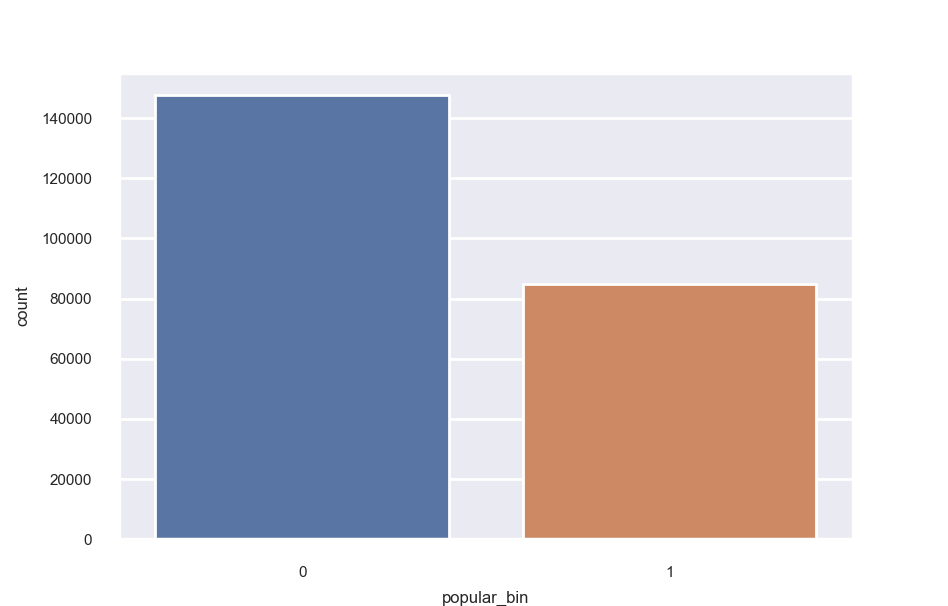

In [12]:
# explore created binary popular measure
sns.countplot(x='popular_bin',data=music)
plt.show()

<IPython.core.display.Javascript object>


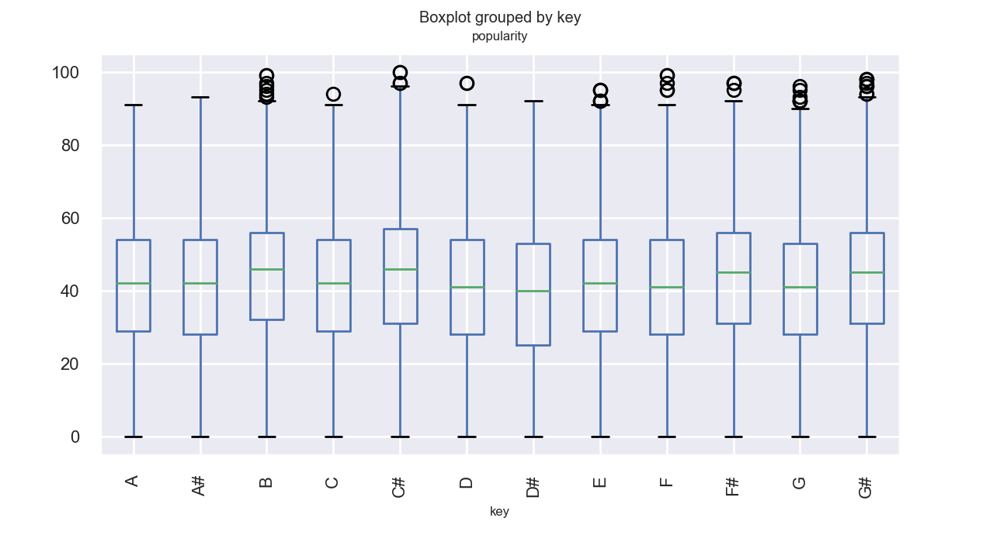

In [13]:
music.boxplot(column='popularity', by='key', rot=90, fontsize=8)
plt.show()

<IPython.core.display.Javascript object>


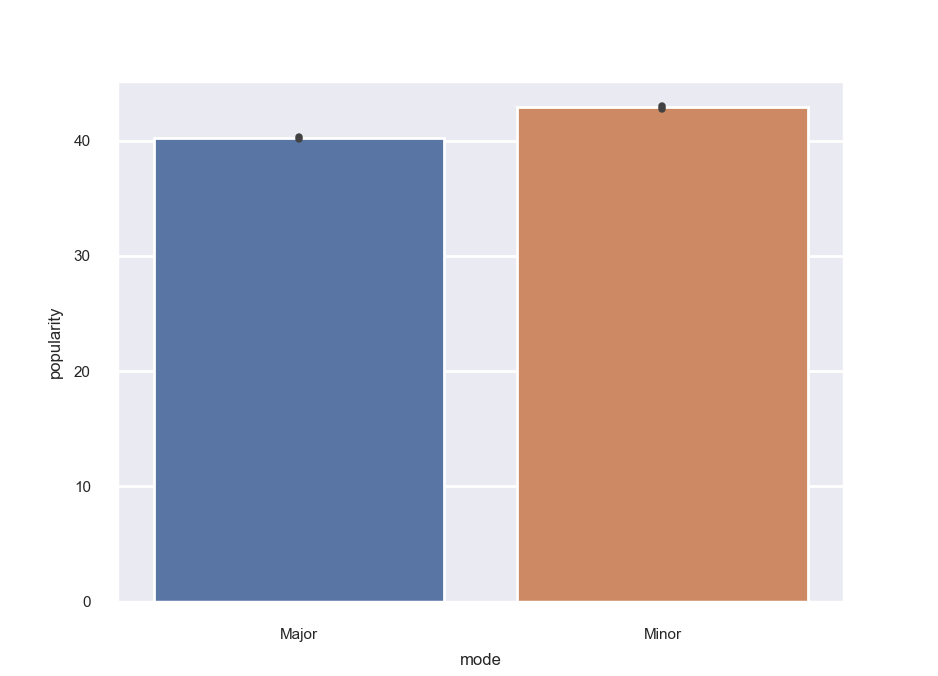

In [13]:
sns.barplot(x = 'mode', y = 'popularity', data = music)
plt.show()

<IPython.core.display.Javascript object>


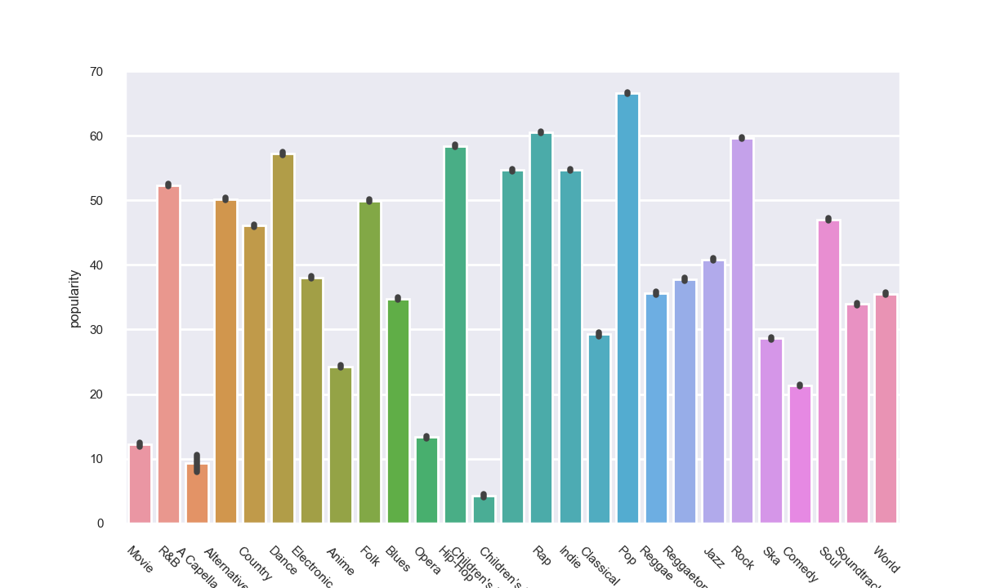

In [25]:
sns.barplot(x = 'genre', y = 'popularity', data = music)
plt.xticks(rotation=-45)
plt.show()

<IPython.core.display.Javascript object>


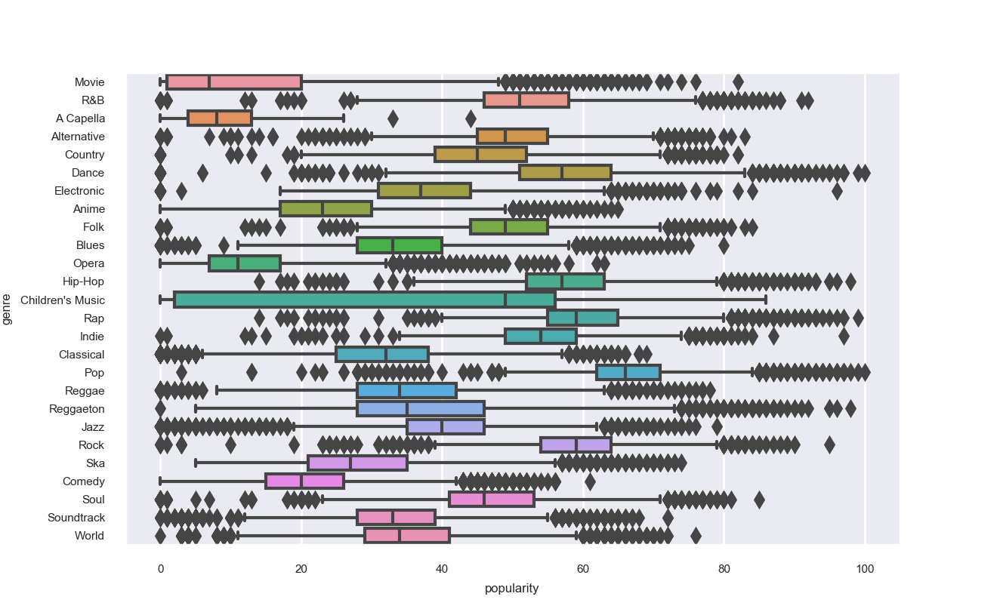

In [136]:
# look at popularity distribution per genre (original continuous measure)
sns.boxplot(x = 'popularity', y = 'genre' , data = music)
plt.ylabel('genre')
plt.show()

<IPython.core.display.Javascript object>


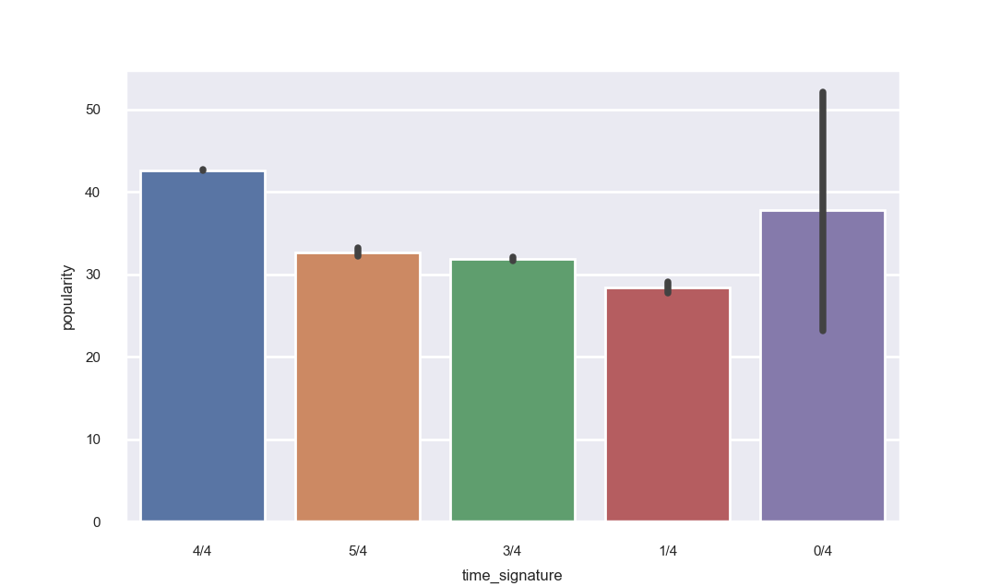

In [66]:
sns.barplot(x = 'time_signature', y = 'popularity', data = music)
plt.show()

In [97]:
# sort by correlation value - for popularity and binary popularity 
music.corr().reindex(music.corr().popularity.abs().
             sort_values(ascending=False).index)[['popularity', 'popular_bin']]

,popularity,popular_bin
popularity,1.000000,0.691450
popular_bin,0.691450,1.000000
acousticness,-0.381295,-0.221421
loudness,0.363011,0.236688
Children's Music,-0.312534,-0.089265
Movie,-0.296531,-0.103243
Opera,-0.293459,-0.110889
Pop,0.286972,0.347912
danceability,0.256564,0.207866
energy,0.248922,0.145842


### Processing and Feature Importance

One hot encoding categorical features, scaling, train/test split, filtering metrics 

In [37]:
# key, mode, time_signature have order
print(music['key'].unique())
print(music['mode'].unique())
print(music['time_signature'].unique())
print(music['genre'].unique())

['C#' 'F#' 'C' 'F' 'G' 'E' 'D#' 'G#' 'D' 'A#' 'A' 'B']
['Major' 'Minor']
['4/4' '5/4' '3/4' '1/4' '0/4']
['Movie' 'R&B' 'A Capella' 'Alternative' 'Country' 'Dance' 'Electronic'
 'Anime' 'Folk' 'Blues' 'Opera' 'Hip-Hop' "Children's Music"
 'Children’s Music' 'Rap' 'Indie' 'Classical' 'Pop' 'Reggae' 'Reggaeton'
 'Jazz' 'Rock' 'Ska' 'Comedy' 'Soul' 'Soundtrack' 'World']


In [9]:
# categorical - genre, key, mode, time_signature - need hot encode
le = preprocessing.LabelEncoder()
music['key_enc'] = le.fit_transform(music['key'])
music['ts_enc'] = le.fit_transform(music['time_signature'])
music['mode_enc'] = np.where(music['mode']=='Major', 1, 0)
# one hot encode genre
music = music.join(pd.get_dummies(music['genre']))

print(music.columns)
music.head()

Index(['genre', 'artist_name', 'track_name', 'track_id', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence', 'popular_bin',
       'key_enc', 'ts_enc', 'mode_enc', 'A Capella', 'Alternative', 'Anime',
       'Blues', 'Children's Music', 'Children’s Music', 'Classical', 'Comedy',
       'Country', 'Dance', 'Electronic', 'Folk', 'Hip-Hop', 'Indie', 'Jazz',
       'Movie', 'Opera', 'Pop', 'R&B', 'Rap', 'Reggae', 'Reggaeton', 'Rock',
       'Ska', 'Soul', 'Soundtrack', 'World'],
      dtype='object')


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.611,0.389,99373,0.910,0.000,...,0,0,0,0,0,0,0,0,0,0
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.246,0.590,137373,0.737,0.000,...,0,0,0,0,0,0,0,0,0,0
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.952,0.663,170267,0.131,0.000,...,0,0,0,0,0,0,0,0,0,0
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.703,0.240,152427,0.326,0.000,...,0,0,0,0,0,0,0,0,0,0
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.950,0.331,82625,0.225,0.123,...,0,0,0,0,0,0,0,0,0,0


In [10]:
# columns to not include in feature data; include song info (metadata)
song_info_cols = ['popularity', 'popular_bin', 'artist_name', 'track_name', 'track_id',
                 'key', 'time_signature', 'mode', 'genre']
# split into features and response
X, y = music.drop(columns=song_info_cols), music['popular_bin']

print(X.shape)
print(y.shape)
X.head()

(232725, 40)
(232725,)


,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
0,0.611,0.389,99373,0.910,0.000,0.3460,-1.828,0.0525,166.969,0.814,...,0,0,0,0,0,0,0,0,0,0
1,0.246,0.590,137373,0.737,0.000,0.1510,-5.559,0.0868,174.003,0.816,...,0,0,0,0,0,0,0,0,0,0
2,0.952,0.663,170267,0.131,0.000,0.1030,-13.879,0.0362,99.488,0.368,...,0,0,0,0,0,0,0,0,0,0
3,0.703,0.240,152427,0.326,0.000,0.0985,-12.178,0.0395,171.758,0.227,...,0,0,0,0,0,0,0,0,0,0
4,0.950,0.331,82625,0.225,0.123,0.2020,-21.150,0.0456,140.576,0.390,...,0,0,0,0,0,0,0,0,0,0


<IPython.core.display.Javascript object>


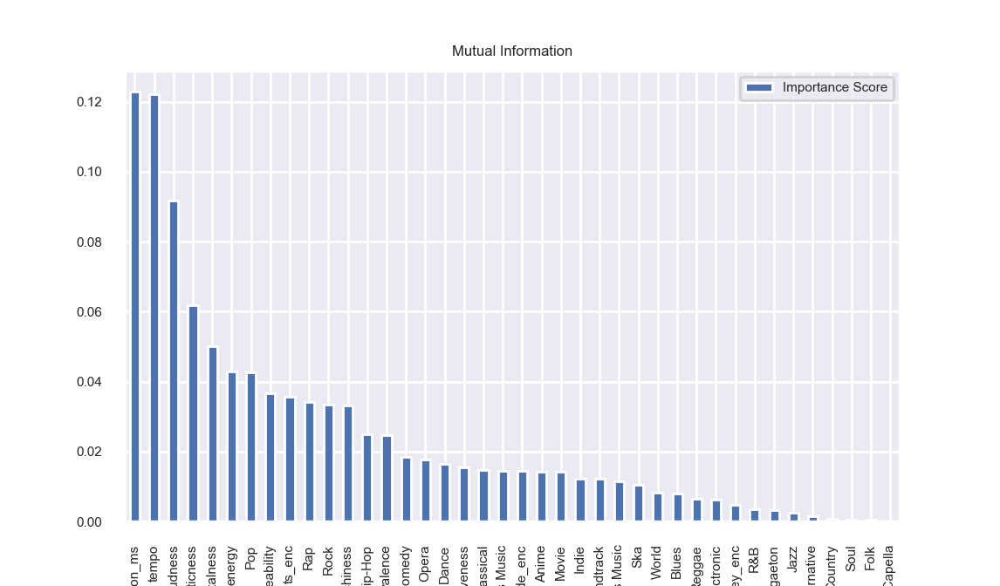

In [62]:
# mutual information filter
feature_scores = mutual_info_classif(X, y.to_numpy().ravel())
    
features_df = pd.DataFrame({'Features': X.columns, 'Importance Score': feature_scores })
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('Mutual Information')
plt.show()

<IPython.core.display.Javascript object>


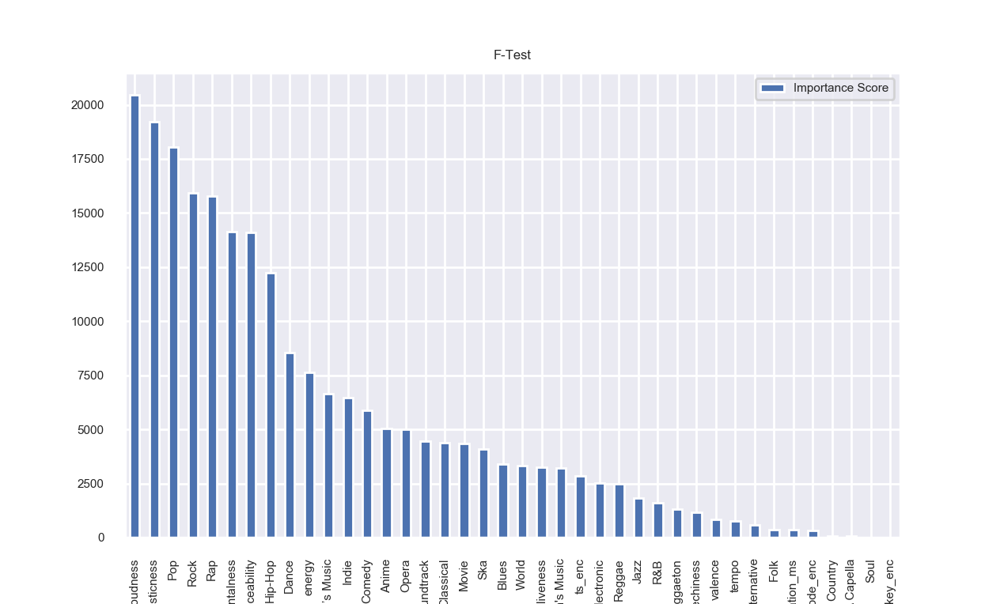

In [65]:
# f score
feature_scores = f_classif(X, y.to_numpy().ravel())[0]
features_df = pd.DataFrame({'Features': X.columns, 'Importance Score': feature_scores })
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('F-Test')
plt.show()

In [11]:
# split into train and test
trainX, testX, trainY, testY = train_test_split(X, y, train_size=0.80, 
                                                random_state=42, shuffle=True)

# scale data
trainX_scale = pd.DataFrame(preprocessing.scale(trainX), columns=trainX.columns)
testX_scale = pd.DataFrame(preprocessing.scale(testX), columns=testX.columns)

trainX_scale.describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,...,Pop,R&B,Rap,Reggae,Reggaeton,Rock,Ska,Soul,Soundtrack,World
count,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,...,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05,1.861800e+05
mean,1.694494e-16,3.930922e-16,-9.770058e-18,2.825302e-16,2.648602e-17,8.926627e-17,2.723404e-16,-8.543076e-17,4.508729e-16,-7.144355e-17,...,6.152083e-17,-4.407975e-17,-5.220875e-17,1.036542e-16,1.094933e-16,-6.640586e-17,-2.245968e-17,-6.564258e-17,1.030436e-17,-6.144451e-17
std,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,...,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00
min,-1.038590e+00,-2.680443e+00,-1.838814e+00,-2.166250e+00,-4.898919e-01,-1.036927e+00,-7.143782e+00,-5.307927e-01,-2.826326e+00,-1.748459e+00,...,-2.041784e-01,-2.014801e-01,-2.029765e-01,-1.977560e-01,-1.992032e-01,-2.039928e-01,-1.979612e-01,-2.021719e-01,-2.083812e-01,-2.014513e-01
25%,-9.329309e-01,-6.430892e-01,-4.376069e-01,-7.049684e-01,-4.898919e-01,-5.944456e-01,-3.687370e-01,-4.525768e-01,-8.008122e-01,-8.371099e-01,...,-2.041784e-01,-2.014801e-01,-2.029765e-01,-1.977560e-01,-1.992032e-01,-2.039928e-01,-1.979612e-01,-2.021719e-01,-2.083812e-01,-2.014513e-01
50%,-3.848983e-01,8.973292e-02,-1.235569e-01,1.300939e-01,-4.897456e-01,-4.401092e-01,3.015375e-01,-3.802945e-01,-5.780219e-02,-4.112135e-02,...,-2.041784e-01,-2.014801e-01,-2.029765e-01,-1.977560e-01,-1.992032e-01,-2.039928e-01,-1.979612e-01,-2.021719e-01,-2.083812e-01,-2.014513e-01
75%,9.985669e-01,7.417291e-01,2.551551e-01,8.209182e-01,-3.716283e-01,2.458301e-01,6.786137e-01,-8.415300e-02,6.928150e-01,7.894754e-01,...,-2.041784e-01,-2.014801e-01,-2.029765e-01,-1.977560e-01,-1.992032e-01,-2.039928e-01,-1.979612e-01,-2.021719e-01,-2.083812e-01,-2.014513e-01
max,1.767785e+00,2.342083e+00,4.449045e+01,1.625615e+00,2.810257e+00,3.957972e+00,2.218737e+00,4.565646e+00,4.053274e+00,2.096896e+00,...,4.897678e+00,4.963269e+00,4.926678e+00,5.056735e+00,5.019999e+00,4.902134e+00,5.051494e+00,4.946285e+00,4.798899e+00,4.963980e+00


In [107]:
# get size of training and test
print(trainX.shape)
print(testX.shape)

(186180, 40)
(46545, 40)


### Modeling

Store best results in table, run logistic regression, random forest, neural networks. Including most model runs here (including different subets, scale/not, regularize, etc.). Marking best models for each type. 

In [73]:
# store top validation (CV/OOB) accuracy, test accuracy, AUC, precision recall
top_models = pd.DataFrame(columns=['Model', 'Validation Accuracy', 'Test Accuracy', 'Test AUC',
                                  'Test Precision', 'Test Recall'])

#### Logistic Regression

In [8]:
# print metrics for train and test
def print_metrics(tr_preds, y_train, te_preds, y_test):
    print("Training Metrics -")
    print(' Accuracy: ', metrics.accuracy_score(y_train, tr_preds), 
          '\tError:', 1-metrics.accuracy_score(y_train, tr_preds))
    print(' Precision: ', metrics.precision_score(y_train, tr_preds))
    print(' Recall: ', metrics.recall_score(y_train, tr_preds))
    print("Testing Metrics -")
    print(' Accuracy: ', metrics.accuracy_score(y_test, te_preds), 
          '\tError:', 1-metrics.accuracy_score(y_test, te_preds))
    print(' Precision: ',metrics.precision_score(y_test, te_preds))
    print(' Recall: ', metrics.recall_score(y_test, te_preds))
    print('Confusion Matrix:')
    print(metrics.confusion_matrix(y_test, te_preds, labels=[0,1]))
    
    # ROC curve
    fpr, tpr, _ = metrics.roc_curve(y_test, te_preds)
    plt.plot(fpr, tpr)
    plt.plot([0,1], [0,1], linestyle='--')
    plt.title('ROC Curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()

Training Metrics -
 Accuracy:  0.7490278225373295 	Error: 0.25097217746267053
 Precision:  0.0
 Recall:  0.0
Testing Metrics -
 Accuracy:  0.7485014502094747 	Error: 0.2514985497905253
 Precision:  0.0
 Recall:  0.0
Confusion Matrix:
[[34839     0]
 [11706     0]]


/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


<IPython.core.display.Javascript object>


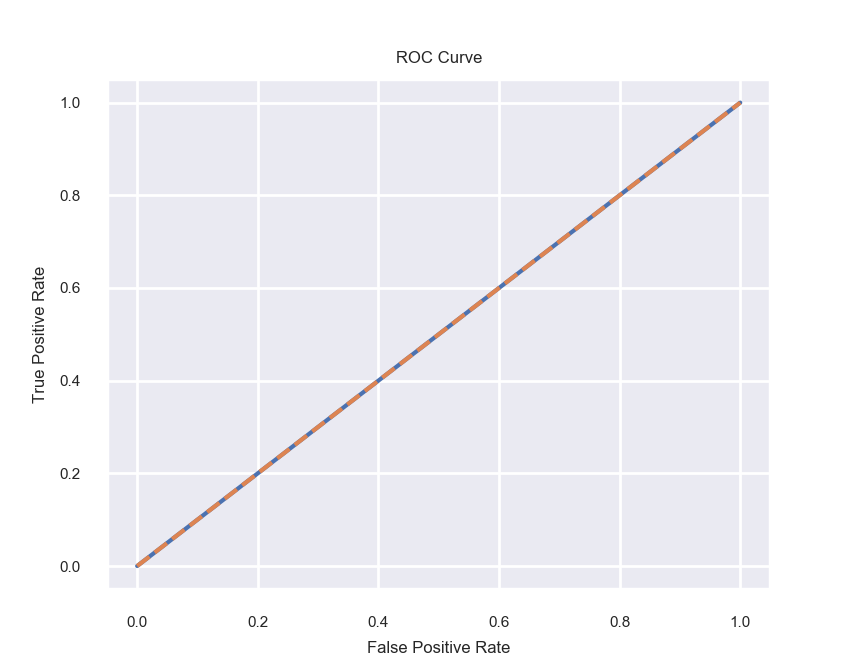

Test Cross-Entropy Loss 0.5725960508586653
AUC: 0.5
Average validation accuracy: 0.7490278226091698


In [37]:
# basic logistic, full feature set, unscaled data
log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX, trainY)
log_tr_preds = log_model.predict(trainX)
log_te_preds = log_model.predict(testX)

# print metrics
print_metrics(log_tr_preds, trainY, log_te_preds, testY)
print("Test Cross-Entropy Loss", metrics.log_loss(testY, log_model.predict_proba(testX)))
print("AUC: " + str(roc_auc_score(testY, log_te_preds)))

# 5 fold cross validation, turn into method
log_val_scores = cross_val_score(log_model, trainX, trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

# get list of predictions
# cross_val_predict(best_svr, X, y, cv=10)

In [38]:
# get coefficients - full feature set, unscaled data
pd.DataFrame(log_model.coef_.reshape(40,1), trainX.columns, columns=['Coefficient'])

,Coefficient
acousticness,-2.187931e-11
danceability,-7.620550e-12
duration_ms,-4.399605e-06
energy,-7.499500e-12
instrumentalness,-1.315547e-11
liveness,-8.152842e-12
loudness,4.601765e-10
speechiness,-4.668762e-12
tempo,-2.598415e-09
valence,-9.334149e-12


Train Accuracy: 0.7519067569019229
Test Accuracy: 0.7507573316145666
Test Error:  0.2492426683854334
Test Cross-Entropy Loss 0.500763787506162
AUC: 0.5220973128658064


<IPython.core.display.Javascript object>


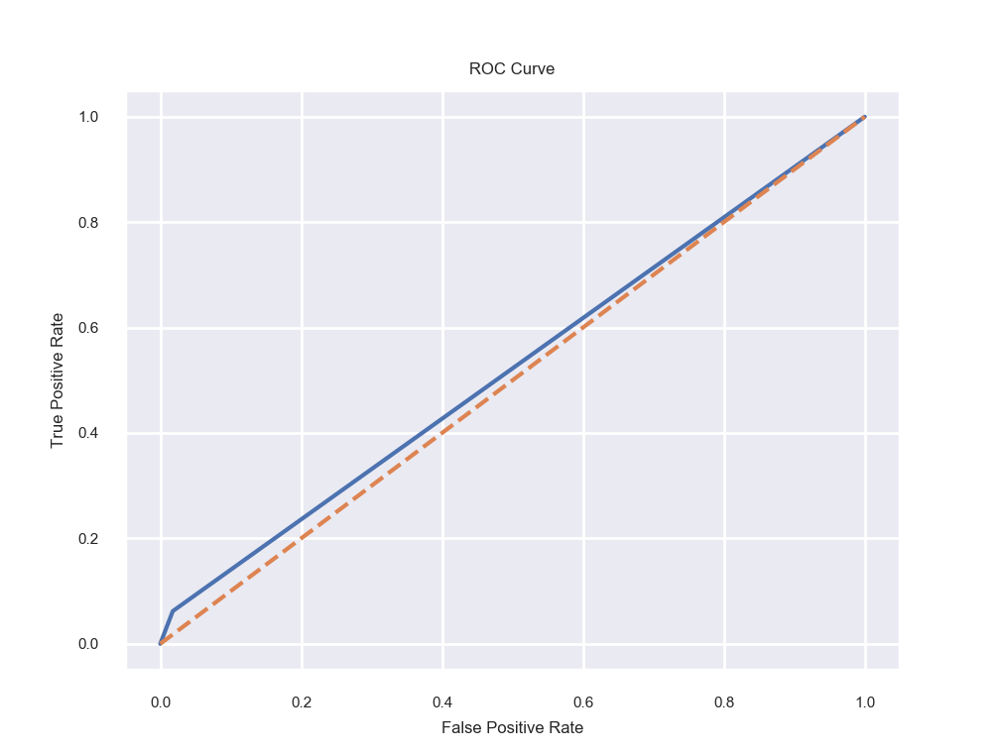

Average validation accuracy: 0.7519228624795544


In [39]:
# logistic on top correlation feature selections
# loud, dance, acoustic, instrument, energy
features = ["acousticness", "danceability", "loudness", "energy", "instrumentalness"]

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_preds = log_model.predict(testX[features])

# print metrics
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, log_preds)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

In [40]:
# logistic - select features - combo of correlation, F-score, mutual information 

features = ["acousticness", "danceability", "duration_ms", "energy", "instrumentalness", 
            "key_enc", "liveness", "mode_enc", "speechiness", "tempo", "ts_enc", "valence"]

feats = ['duration_ms', 'loudness', 'tempo', 'instrumentalness', 'acousticness', 'energy', 
         'Pop', 'danceability', 'ts_enc', 'Rap', 'Rock', 'speechiness']

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_preds = log_model.predict(testX[features])
print("Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print(log_val_scores.mean())

Accuracy: 0.7485014502094747
AUC: 0.5
0.7490278226091698


###### *Best Logistic model:* 

Training Metrics -
 Accuracy:  0.8441024814695456 	Error: 0.15589751853045442
 Precision:  0.7458813724128351
 Recall:  0.5745837435260882
Testing Metrics -
 Accuracy:  0.8471586636588248 	Error: 0.15284133634117525
 Precision:  0.755054432348367
 Recall:  0.5806424056039637
Confusion Matrix:
[[32634  2205]
 [ 4909  6797]]


<IPython.core.display.Javascript object>


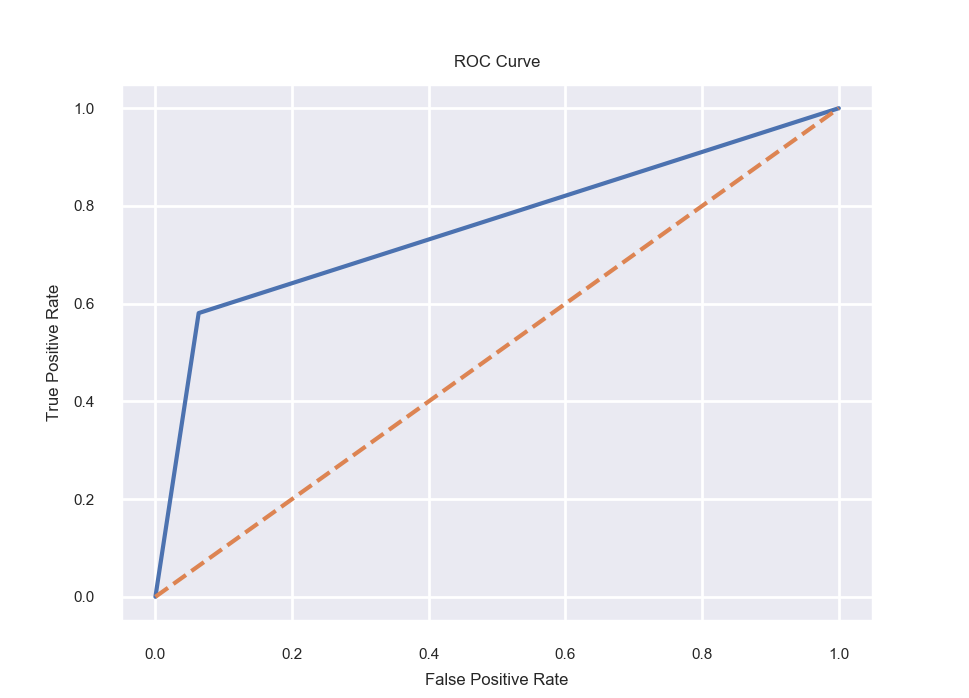

Test Cross-Entropy Loss 0.39215997410079356
AUC: 0.7586756331817288
Average validation accuracy: 0.8440595148515646


In [74]:
# logistic - use F-score - BEST LOGISTIC (7500 was best threshold)
features = ['loudness', 'acousticness', 'Pop', 'Rock', 'Rap', 'instrumentalness',
           'danceability', 'Hip-Hop', 'Dance']

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_tr_preds = log_model.predict(trainX[features])
log_te_preds = log_model.predict(testX[features])

# print metrics
print_metrics(log_tr_preds, trainY, log_te_preds, testY)
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, log_te_preds)))

# 5 fold cross validation, turn into method
log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

<IPython.core.display.Javascript object>


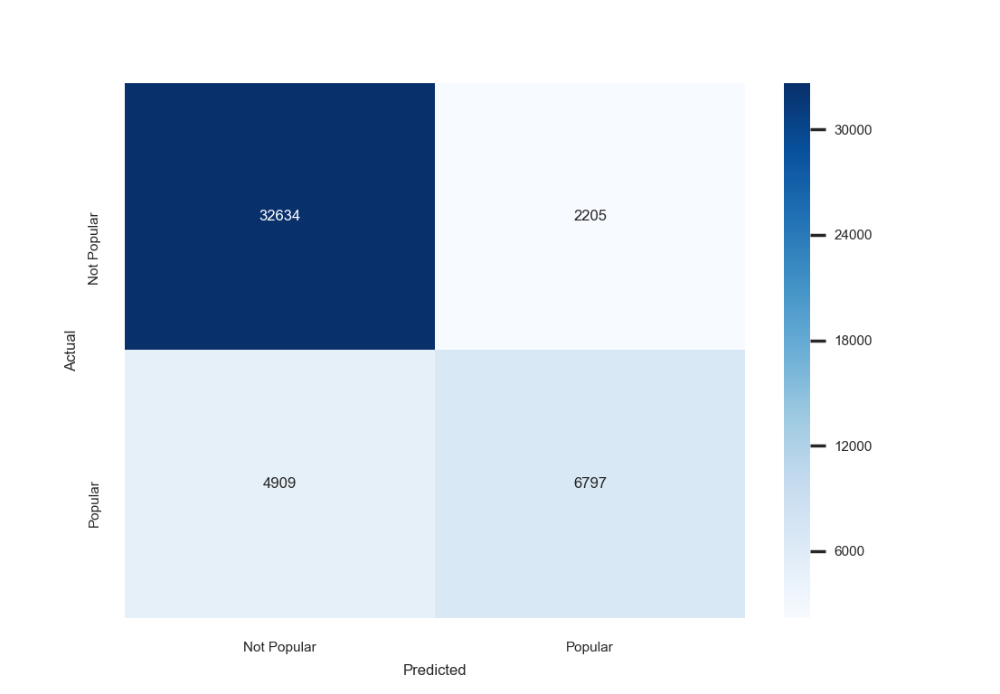

In [126]:
# print confusion matrix nicer (for slides/report)
cm_log = metrics.confusion_matrix(testY, log_te_preds, labels=[0,1])
#classes = [0,1] 
classes = ['Not Popular', 'Popular']
sns.heatmap(pd.DataFrame(cm_log, index=classes, columns=classes),
annot=True, cmap='Blues', fmt='d') 
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [75]:
# append to top scores table
name = 'Logistic'
val_acc = log_val_scores.mean()
test_acc = metrics.accuracy_score(testY, log_te_preds)
test_auc = roc_auc_score(testY, log_te_preds)
test_prec = metrics.precision_score(testY, log_te_preds)
test_rec = metrics.recall_score(testY, log_te_preds)

top_models = top_models.append({'Model': name, 'Validation Accuracy': val_acc, 
                                'Test Accuracy': test_acc, 'Test AUC': test_auc, 
                                'Test Precision': test_prec,'Test Recall': test_rec},
                               ignore_index=True)

In [51]:
# logistic - use mutual information criteria
features = ['duration_ms', 'tempo', 'loudness', 'acousticness', 'instrumentalness',
           'energy', 'Pop', 'danceability', 'ts_enc', 'Rap', 'Rock', 'speechiness',
           'Hip-Hop', 'valence', 'Comedy']

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_preds = log_model.predict(testX[features])
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

Train Accuracy: 0.7490278225373295
Test Accuracy: 0.7485014502094747
Test Error:  0.2514985497905253
Test Cross-Entropy Loss 0.5725960508745305
AUC: 0.5
Average validation accuracy: 0.7490278226091698


In [64]:
# logistic on scaled data (similar to unscaled, so keep scaled results)
log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX, trainY)
log_preds = log_model.predict(testX)
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX)))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX, trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

Train Accuracy: 0.7490278225373295
Test Accuracy: 0.7485014502094747
Test Error:  0.2514985497905253
Test Cross-Entropy Loss 0.5725960508586653
AUC: 0.5
Average validation accuracy: 0.7490278226091698


<IPython.core.display.Javascript object>


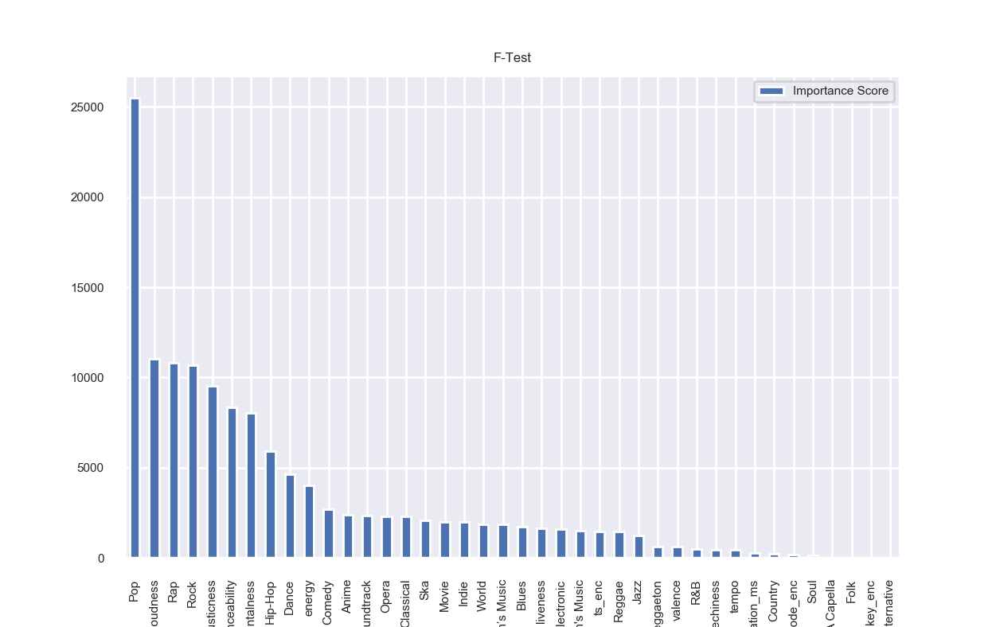

In [46]:
# f score on scaled data
from sklearn.feature_selection import mutual_info_classif, f_classif, chi2
feature_scores = f_classif(trainX_scale, trainY.to_numpy().ravel())[0]
features_df = pd.DataFrame({'Features': trainX_scale.columns, 'Importance Score': feature_scores })
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('F-Test')
plt.show()

Training Metrics -
 Accuracy:  0.8272048555161672 	Error: 0.17279514448383282
 Precision:  0.829910694047781
 Recall:  0.39179471814407396
Testing Metrics -
 Accuracy:  0.8288323128155548 	Error: 0.1711676871844452
 Precision:  0.8341376228775692
 Recall:  0.39868443533230824
Confusion Matrix:
[[33911   928]
 [ 7039  4667]]


<IPython.core.display.Javascript object>


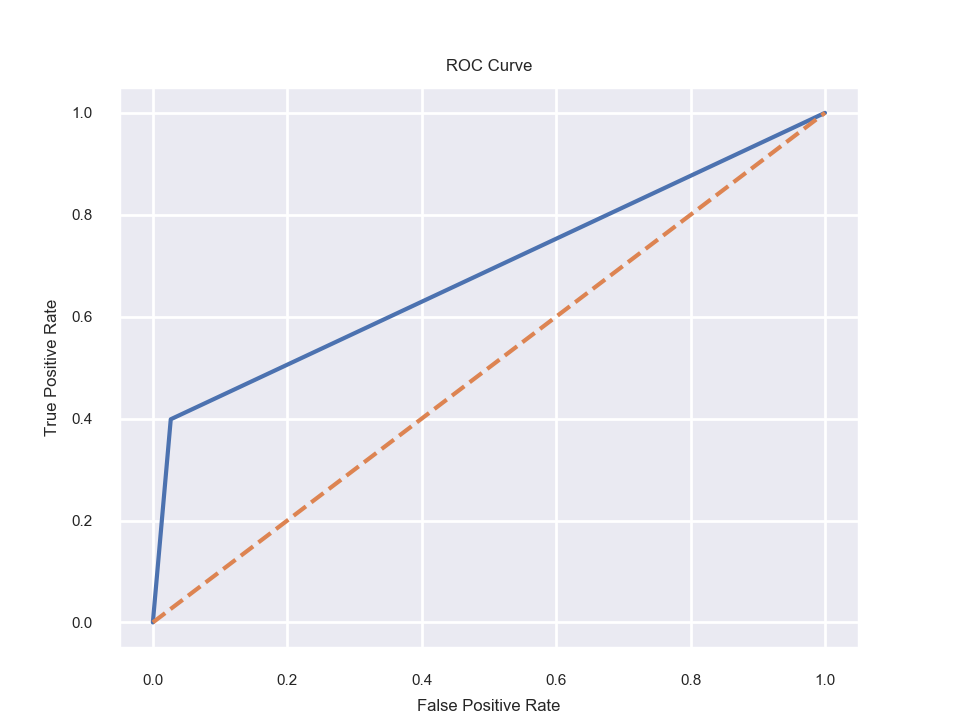

Test Cross-Entropy Loss 0.4203269535492335
AUC: 0.686023810134365
Average validation accuracy: 0.8272370752756208


In [54]:
# logistic - scaled data, F-score features
features = ['Pop', 'loudness', 'Rap', 'Rock', 'acousticness', 'danceability',
           'instrumentalness']

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_tr_preds = log_model.predict(trainX[features])
log_te_preds = log_model.predict(testX[features])

# print metrics
print_metrics(log_tr_preds, trainY, log_te_preds, testY)
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, log_te_preds)))

# 5 fold cross validation, turn into method
log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

<IPython.core.display.Javascript object>


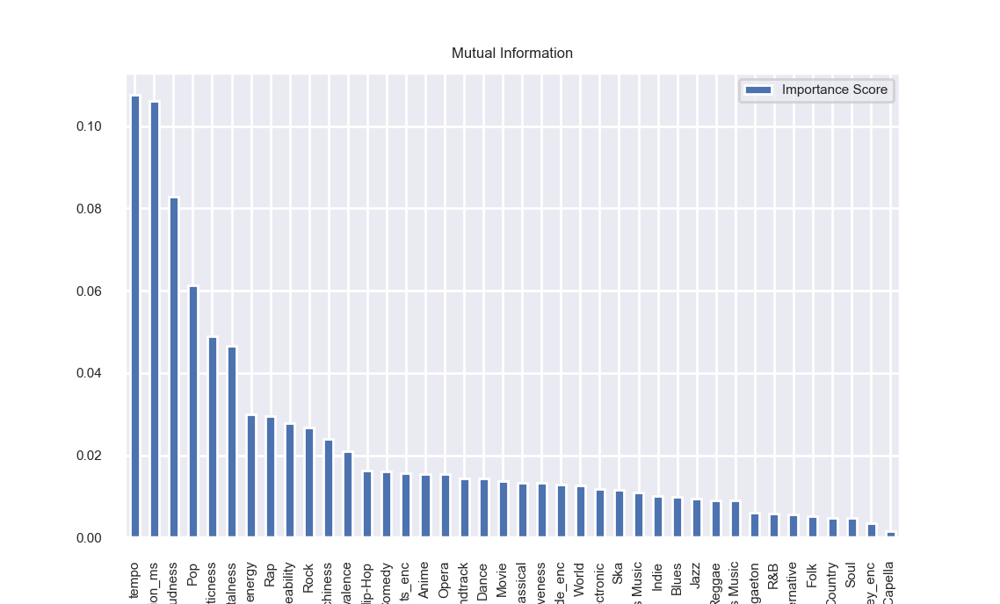

In [48]:
# mutual info on scaled data
feature_scores = mutual_info_classif(trainX_scale, trainY.to_numpy().ravel())
    
features_df = pd.DataFrame({'Features': trainX_scale.columns, 
                            'Importance Score': feature_scores })
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('Mutual Information')
plt.show()

In [53]:
# logistic - scaled data, mutual features
features = ['tempo', 'duration_ms', 'loudness', 'Pop', 'acousticness', 'instrumentalness']

log_model = LogisticRegression(solver='lbfgs')
log_model.fit(trainX[features], trainY)
log_preds = log_model.predict(testX[features])
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

Train Accuracy: 0.7490278225373295
Test Accuracy: 0.7485014502094747
Test Error:  0.2514985497905253
Test Cross-Entropy Loss 0.5725960508780288
AUC: 0.5
Average validation accuracy: 0.7490278226091698


In [62]:
# logistic with lasso, scale, F score features
features = ['Pop', 'loudness', 'Rap', 'Rock', 'acousticness', 'danceability',
           'instrumentalness']

log_model = LogisticRegression(penalty='l1', solver='liblinear')
log_model.fit(trainX_scale[features], trainY)
log_preds = log_model.predict(testX[features])
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX_scale[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX_scale[features])))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX_scale[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

Train Accuracy: 0.8272102266623698
Test Accuracy: 0.7485014502094747
Test Error:  0.2514985497905253
Test Cross-Entropy Loss 0.4203156789170039
AUC: 0.5
Average validation accuracy: 0.8272370752756208


In [63]:
# logistic with ridge, scale, F-score features
log_model = LogisticRegression(penalty='l2', solver='liblinear')
log_model.fit(trainX_scale[features], trainY)
log_preds = log_model.predict(testX[features])
print('Train Accuracy:', str(metrics.accuracy_score(trainY, 
                                                    log_model.predict(trainX_scale[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, log_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, log_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, 
                                                  log_model.predict_proba(testX_scale[features])))
print("AUC: " + str(roc_auc_score(testY, log_preds)))

log_val_scores = cross_val_score(log_model, trainX_scale[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', log_val_scores.mean())

Train Accuracy: 0.8272102266623698
Test Accuracy: 0.7485014502094747
Test Error:  0.2514985497905253
Test Cross-Entropy Loss 0.4203154142340744
AUC: 0.5
Average validation accuracy: 0.8272370752756208


#### Random Forest

OOB Score:  0.8450424320550005
Train Accuracy: 0.9996723600816414
Test Accuracy: 0.847652809109464
Test Error:  0.15234719089053606
Test Cross-Entropy Loss 0.33869013649601803
AUC: 0.7732715103961638


<IPython.core.display.Javascript object>


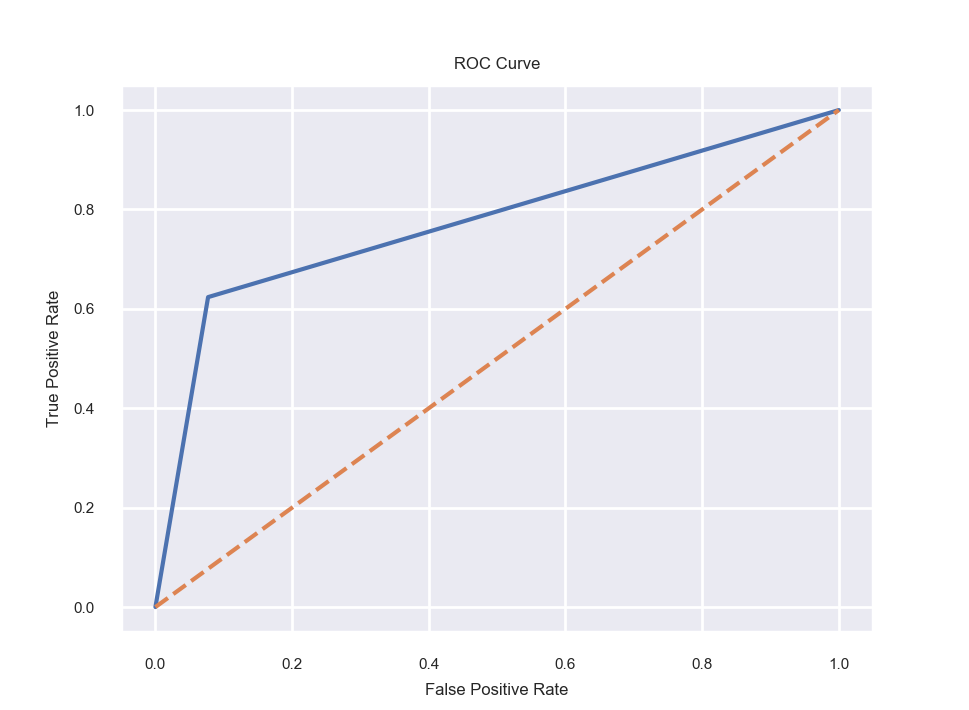

Average validation accuracy: 0.8473788863790134


In [66]:
# simple random forest - full feature set
rf_model = RandomForestClassifier(n_estimators=100, oob_score = True)
rf_model.fit(trainX, trainY)
rf_preds = rf_model.predict(testX)

print('OOB Score: ', rf_model.oob_score_)
print('Train Accuracy:', str(metrics.accuracy_score(trainY, rf_model.predict(trainX))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, rf_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, rf_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, rf_model.predict_proba(testX)))
print("AUC: " + str(roc_auc_score(testY, rf_preds)))

# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, rf_preds)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

rf_val_scores = cross_val_score(rf_model, trainX, trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', rf_val_scores.mean())

In [68]:
# simple random forest - other metrics
print('Test Precision: ',metrics.precision_score(testY, rf_preds))
print('Test Recall: ', metrics.recall_score(testY, rf_preds))
print('Test Confusion Matrix:')
print(metrics.confusion_matrix(testY, rf_preds, labels=[0,1]))

Test Precision:  0.7310966449674512
Test Recall:  0.6236118229967538
Test Confusion Matrix:
[[32154  2685]
 [ 4406  7300]]


<IPython.core.display.Javascript object>


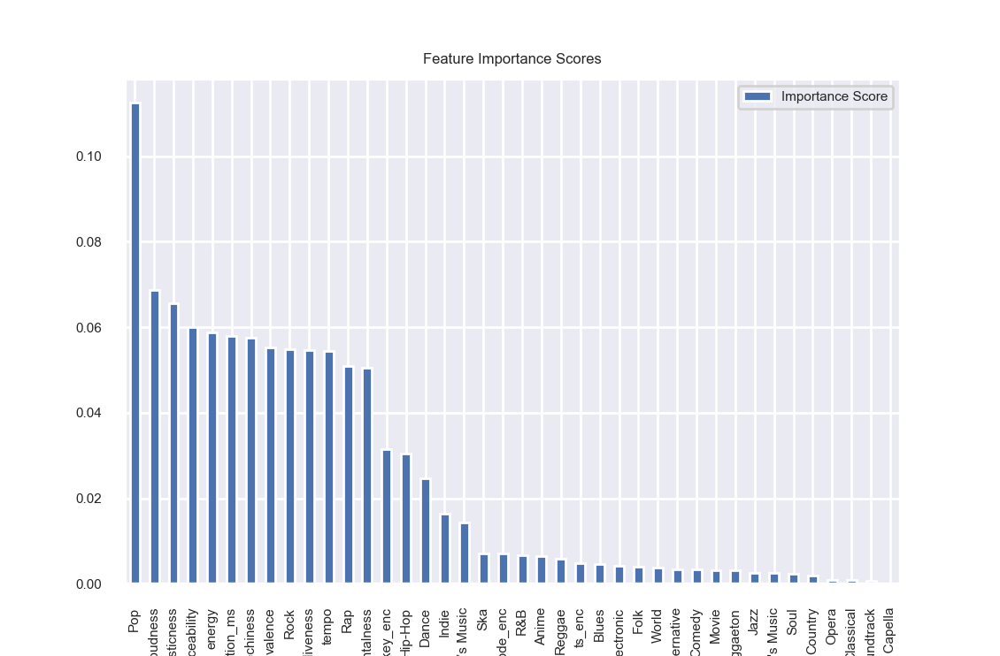

In [71]:
# feature importance - full feature set
feature_scores = rf_model.feature_importances_

features_df = pd.DataFrame({'Features': trainX.columns, 'Importance Score': feature_scores})
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('Feature Importance Scores')
plt.show()

OOB Score:  0.8917338059941992
Train Accuracy: 0.9925770759480073
Test Accuracy: 0.8950263186163927
Test Error:  0.1049736813836073
Test Cross-Entropy Loss 0.3094411560153119
AUC: 0.8426093889988697


<IPython.core.display.Javascript object>


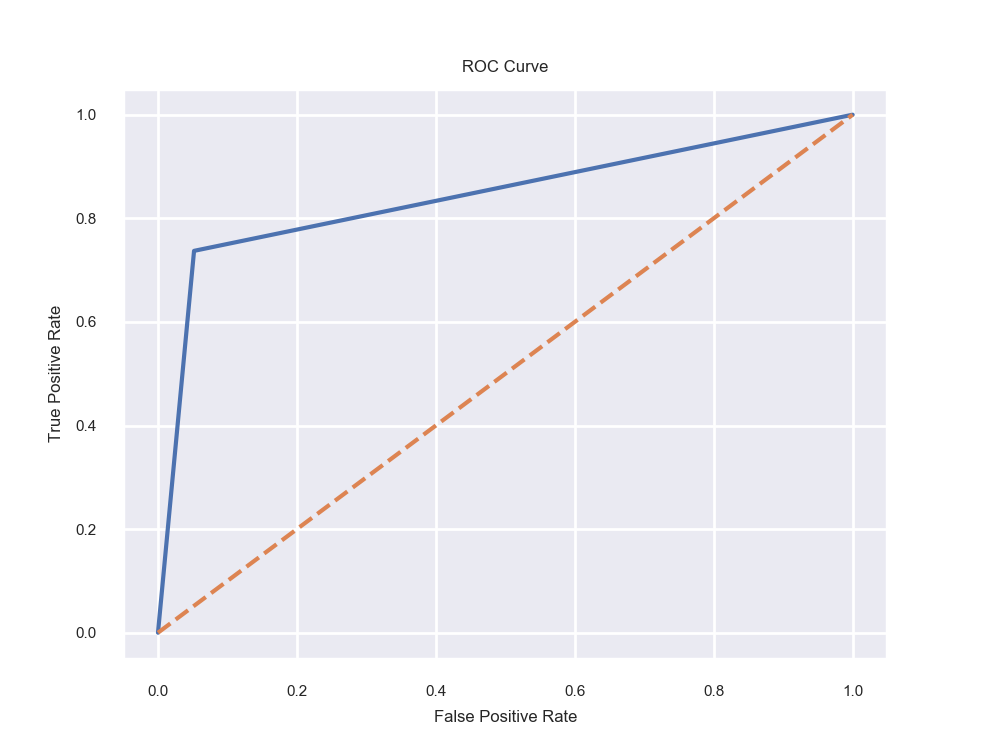

Test Precision:  0.8266909369611036
Test Recall:  0.7371433452930122
Test Confusion Matrix:
[[33030  1809]
 [ 3077  8629]]
Average validation accuracy: 0.8852669453559701


In [69]:
# subset random forest - try with different thresholds for feature importance
features = ['loudness', 'acousticness', 'Pop', 'Rock', 'Rap', 'energy', 'danceability',
           'speechiness', 'duration_ms', 'instrumentalness', 'valence', 'liveness',
           'Hip-Hop', 'tempo']

rf_model = RandomForestClassifier(n_estimators=100, oob_score = True)
rf_model.fit(trainX[features], trainY)
rf_preds = rf_model.predict(testX[features])

print('OOB Score: ', rf_model.oob_score_)
print('Train Accuracy:', str(metrics.accuracy_score(trainY, rf_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, rf_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, rf_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, rf_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, rf_preds)))

# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, rf_preds)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

# other test metrics
print('Test Precision: ',metrics.precision_score(testY, rf_preds))
print('Test Recall: ', metrics.recall_score(testY, rf_preds))
print('Test Confusion Matrix:')
print(metrics.confusion_matrix(testY, rf_preds, labels=[0,1]))

rf_val_scores = cross_val_score(rf_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', rf_val_scores.mean())

In [105]:
# smaller subset random forest (different threshold)
features = ['loudness', 'acousticness', 'Pop', 'Rock', 'Rap', 'energy', 'danceability',
           'speechiness', 'duration_ms', 'instrumentalness']

rf_model = RandomForestClassifier(n_estimators=200, oob_score = True)
rf_model.fit(trainX[features], trainY)
rf_preds = rf_model.predict(testX[features])

print('OOB Score: ', rf_model.oob_score_)
print('Train Accuracy:', str(metrics.accuracy_score(trainY, rf_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, rf_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, rf_preds))
print("AUC: " + str(roc_auc_score(testY, rf_preds)))

OOB Score:  0.8860565044580514
Train Accuracy: 0.9927758083575035
Test Accuracy: 0.8895692340745515
Test Error:  0.11043076592544854
AUC: 0.84560061808225


###### *Best Random Forest model:* 

OOB Score:  0.91442152755398
Train Accuracy: 0.9913685680524223
Test Accuracy: 0.9199054678268342
Test Error:  0.08009453217316576
Test Cross-Entropy Loss 0.2879213801697756
AUC: 0.8597959230752448


<IPython.core.display.Javascript object>


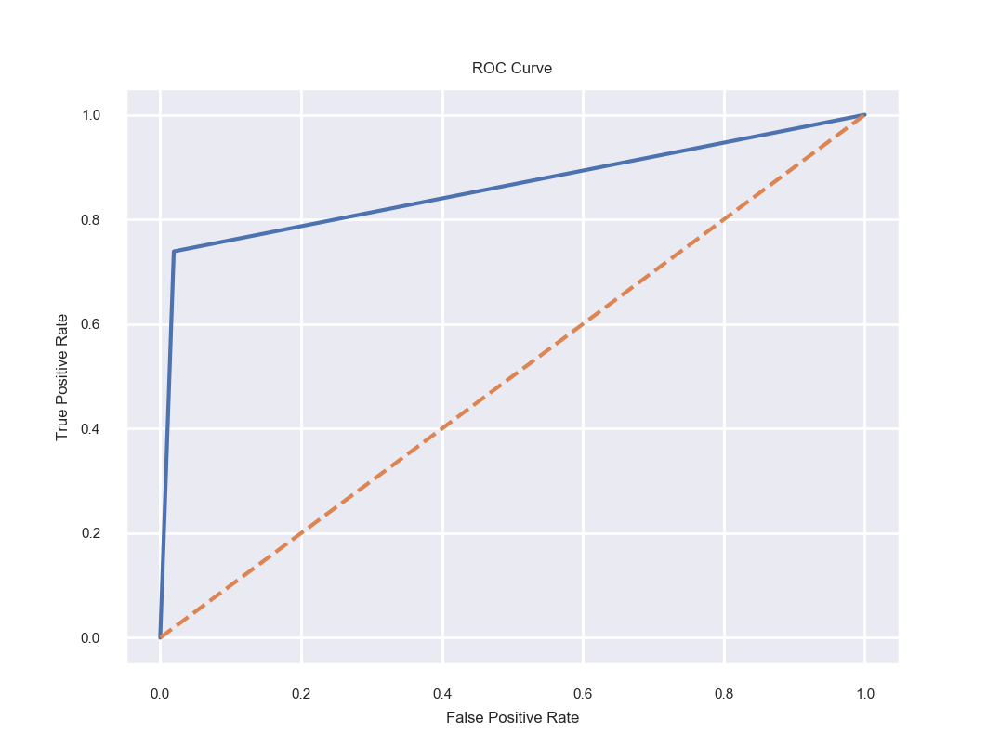

Test Precision:  0.9280042918454936
Test Recall:  0.738851870835469
Test Confusion Matrix:
[[34168   671]
 [ 3057  8649]]
Average validation accuracy: 0.9000913220062585


In [72]:
# random forest - feature importance subset - BEST RANDOM FOREST (0.05 was best threshold)
features = ['Pop', 'loudness', 'acousticness', 'energy', 'danceability', 'duration_ms',
           'speechiness', 'valence']

rf_model = RandomForestClassifier(n_estimators=100, oob_score = True)
rf_model.fit(trainX[features], trainY)
rf_preds = rf_model.predict(testX[features])

print('OOB Score: ', rf_model.oob_score_)
print('Train Accuracy:', str(metrics.accuracy_score(trainY, rf_model.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, rf_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, rf_preds))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, rf_model.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, rf_preds)))

# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, rf_preds)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

# other test metrics
print('Test Precision: ',metrics.precision_score(testY, rf_preds))
print('Test Recall: ', metrics.recall_score(testY, rf_preds))
print('Test Confusion Matrix:')
print(metrics.confusion_matrix(testY, rf_preds, labels=[0,1]))

rf_val_scores = cross_val_score(rf_model, trainX[features], trainY, scoring='accuracy', cv=5)
# print(log_val_scores)
print('Average validation accuracy:', rf_val_scores.mean())

<IPython.core.display.Javascript object>


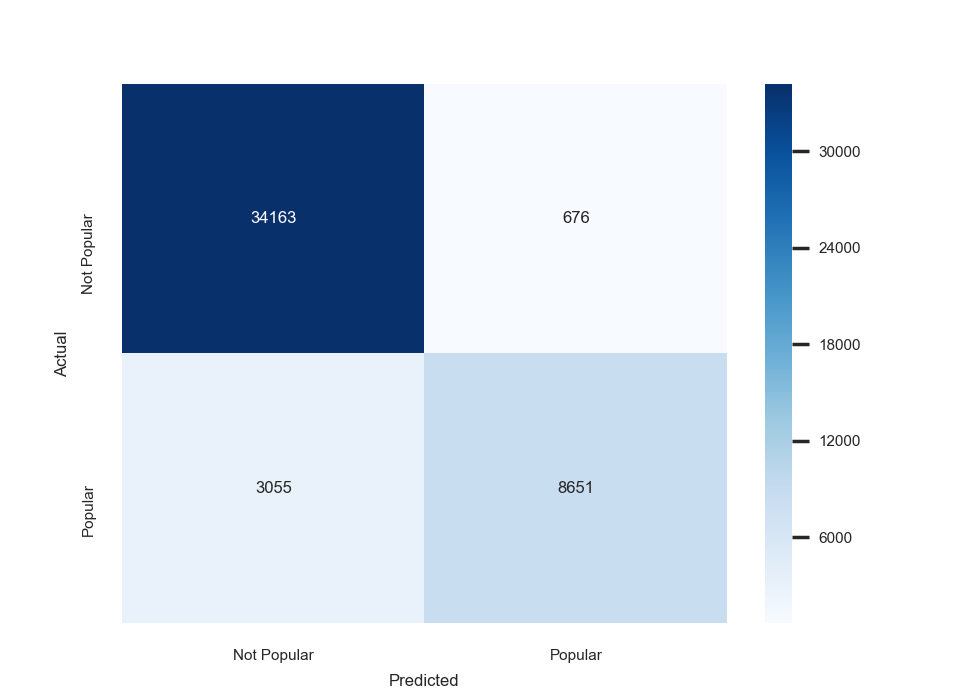

In [127]:
# print confusion matrix nicer
cm_rf = metrics.confusion_matrix(testY, rf_preds, labels=[0,1])
#classes = [0,1] 
classes = ['Not Popular', 'Popular']
sns.heatmap(pd.DataFrame(cm_rf, index=classes, columns=classes),
annot=True, cmap='Blues', fmt='d') 
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [84]:
# append top scores table - use OOB for RF
name = 'Random Forest'
val_acc = rf_model.oob_score_
test_acc = metrics.accuracy_score(testY, rf_preds)
test_auc = roc_auc_score(testY, rf_preds)
test_prec = metrics.precision_score(testY, rf_preds)
test_rec = metrics.recall_score(testY, rf_preds)

top_models = top_models.append({'Model': name, 'Validation Accuracy': val_acc, 
                                'Test Accuracy': test_acc, 'Test AUC': test_auc, 
                                'Test Precision': test_prec,'Test Recall': test_rec},
                               ignore_index=True)

In [86]:
# some tuning (on best model subset)
# validation curve for number estimators
from sklearn.model_selection import validation_curve

features = ['Pop', 'loudness', 'acousticness', 'energy', 'danceability', 'duration_ms',
           'speechiness', 'valence']

n_est = [10, 50, 100, 200, 300, 500]
train_scores, val_scores = validation_curve(RandomForestClassifier(), trainX[features], trainY, 
                                             param_name="n_estimators", param_range=n_est, 
                                             cv=3, scoring="accuracy", n_jobs=-1)
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
val_mean = np.mean(val_scores, axis=1)
val_std = np.std(val_scores, axis=1)

<IPython.core.display.Javascript object>


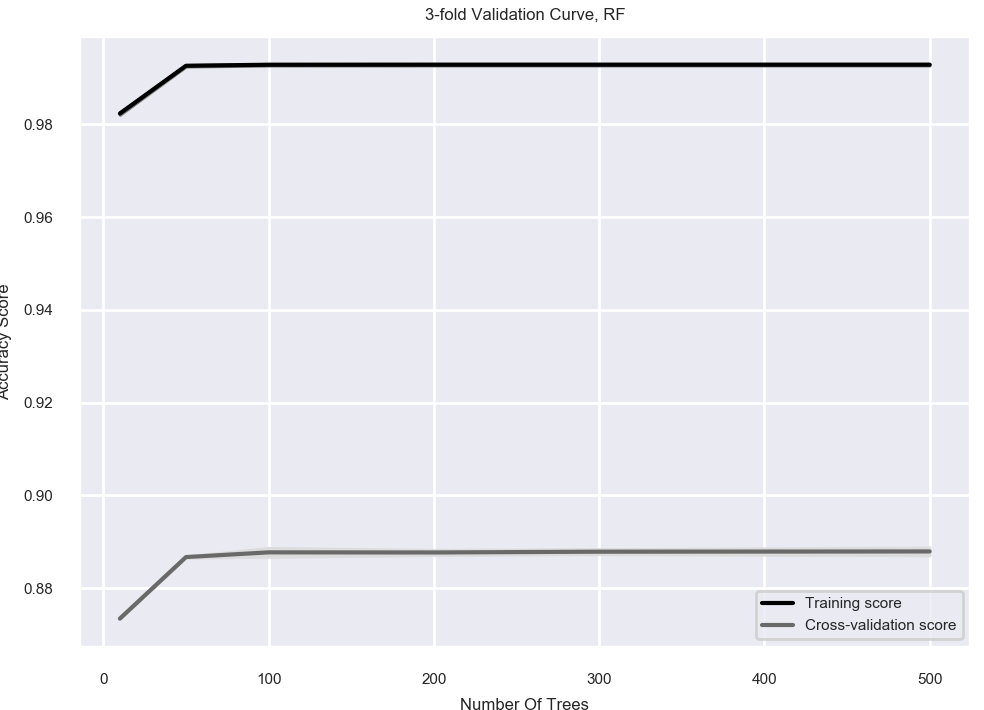

In [74]:
# plot validation curve
plt.plot(n_est, train_mean, label="Training score", color="black")
plt.plot(n_est, val_mean, label="Cross-validation score", color="dimgrey")

# accuracy bands
plt.fill_between(n_est, train_mean - train_std, train_mean + train_std, color="gray")
plt.fill_between(n_est, val_mean - val_std, val_mean + val_std, color="gainsboro")

plt.title("3-fold Validation Curve, RF")
plt.xlabel("Number Of Trees")
plt.ylabel("Accuracy Score")
plt.tight_layout()
plt.legend(loc="best")
plt.show()

In [76]:
# tuning number of estimators - bigger range (on best subset)
features = ['Pop', 'loudness', 'acousticness', 'energy', 'danceability', 'duration_ms',
           'speechiness', 'valence']

rf_tr_errs = list()
rf_te_errs = list()
rf_oobs = list()
n_est = [10, 50, 100, 200, 300, 500, 700, 1000]
for n in n_est:
    # to track as go through loop
    print('\033[1m'+str(n), 'Base Classifiers (Decision Trees)\033[0m')
    rfm = RandomForestClassifier(n_estimators=n, oob_score = True)
    rfm.fit(trainX[features], trainY)
    rf_tr_errs.append(1-metrics.accuracy_score(trainY, rfm.predict(trainX[features])))
    rf_te_preds = rfm.predict(testX[features])
    rf_te_errs.append(1-metrics.accuracy_score(testY, rf_te_preds))
    rf_oobs.append(rfm.oob_score_)

10 Base Classifiers (Decision Trees)


/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:460: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.
  warn("Some inputs do not have OOB scores. "
/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:465: RuntimeWarning: divide by zero encountered in true_divide
  predictions[k].sum(axis=1)[:, np.newaxis])
/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/ensemble/forest.py:465: RuntimeWarning: invalid value encountered in true_divide
  predictions[k].sum(axis=1)[:, np.newaxis])


50 Base Classifiers (Decision Trees)
100 Base Classifiers (Decision Trees)
200 Base Classifiers (Decision Trees)
300 Base Classifiers (Decision Trees)
500 Base Classifiers (Decision Trees)
700 Base Classifiers (Decision Trees)
1000 Base Classifiers (Decision Trees)


<IPython.core.display.Javascript object>


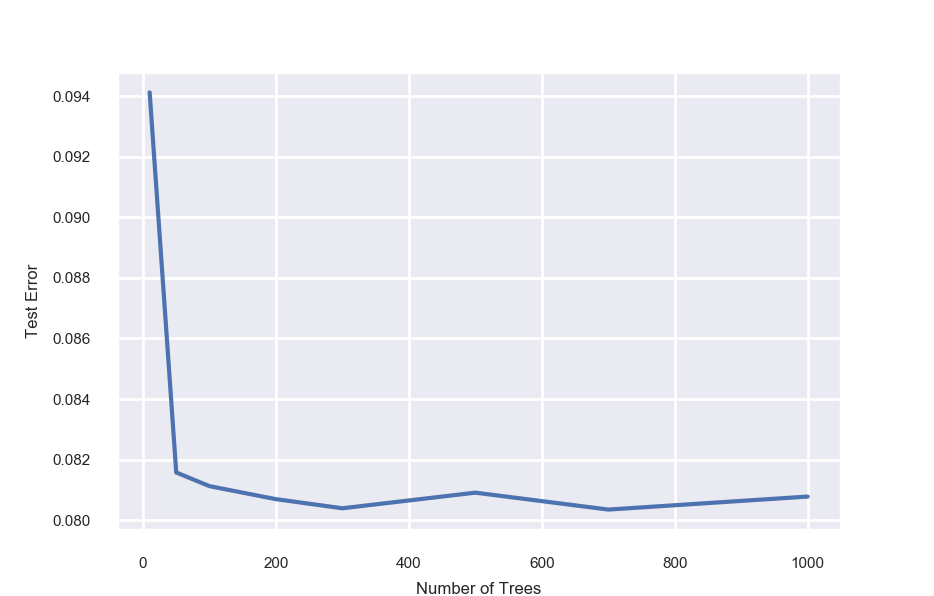

In [80]:
# plot test errors    
plt.plot(n_est, rf_te_errs)
plt.xlabel('Number of Trees')
plt.ylabel('Test Error')
plt.show()

<IPython.core.display.Javascript object>


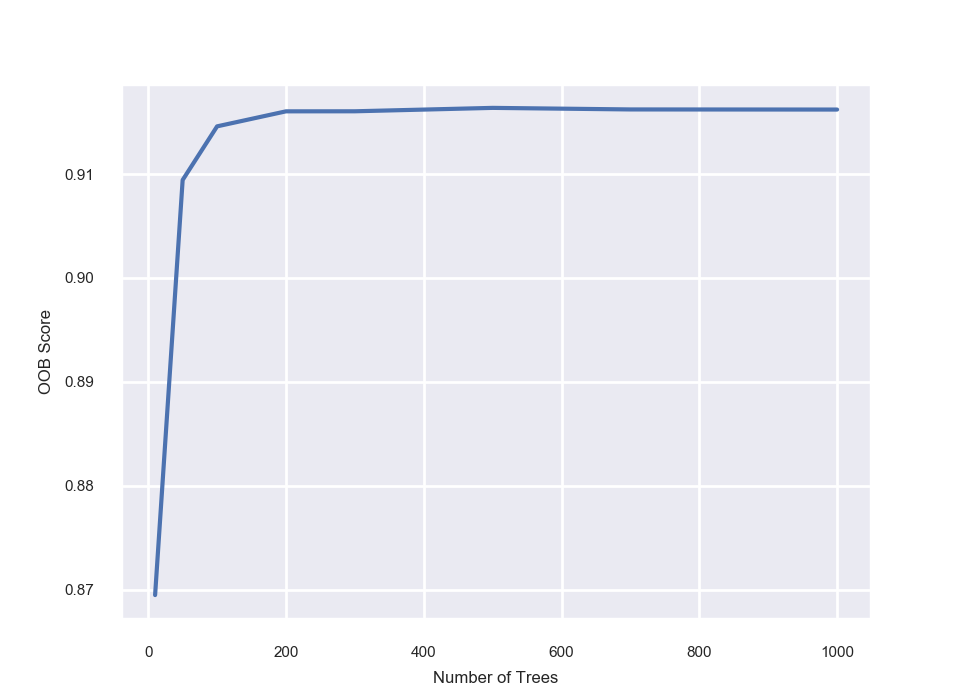

[0.8694811472768289, 0.9094263615855623, 0.9145880330862606, 0.9160328714147599, 0.9160382425609626, 0.916365882479321, 0.9162154903856483, 0.9162047480932431]


In [82]:
# plot oob scores   
plt.plot(n_est, rf_oobs)
plt.xlabel('Number of Trees')
plt.ylabel('OOB Score')
plt.show()

print(rf_oobs)

In [84]:
# run random search CV for initial tuning of estimators, depth
from sklearn.model_selection import RandomizedSearchCV

model_params = {'n_estimators': [50, 100, 500, 1000],
                'max_depth': [1, 5, 10, 20, 30, None],
                'criterion': ["gini", "entropy"]}

rf_search = RandomizedSearchCV(estimator=RandomForestClassifier(), 
                            param_distributions=model_params, n_iter = 15 ,cv = 3, 
                            random_state=42, n_jobs=-1)

rf_search_mod = rf_search.fit(trainX[features], trainY)

print('Best score: ', rf_search_mod.best_score_)
pprint(rf_search_mod.best_params_)

Best score:  0.8880223439682028
{'criterion': 'gini', 'max_depth': 30, 'n_estimators': 1000}


Train Accuracy: 0.9910462992802664
Test Accuracy: 0.9191105381888495
Test Error:  0.08088946181115053
Test Cross-Entropy Loss 0.27894462576744716
AUC: 0.8565989367889539


<IPython.core.display.Javascript object>


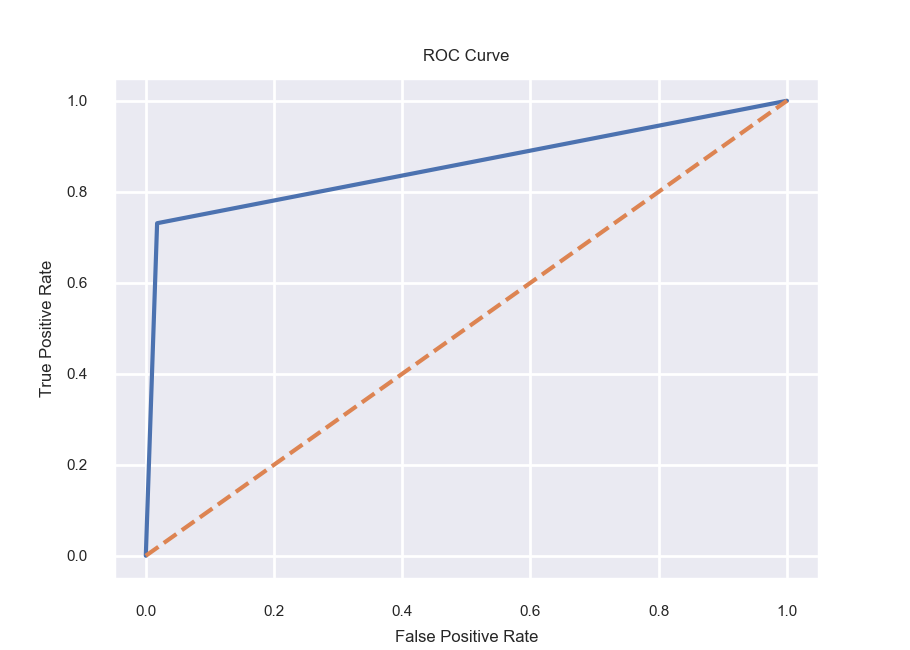

Test Precision:  0.9330352273966627
Test Recall:  0.7308218007859217
Test Confusion Matrix:
[[34225   614]
 [ 3151  8555]]
Average validation accuracy: 0.8999731546259284


In [88]:
# predict and metrics with randomized cv model
# similar to best model results so keep those (smaller parameters with comparable performance)
rf_preds_search = rf_search_mod.predict(testX[features])

print('Train Accuracy:', str(metrics.accuracy_score(trainY, rf_search_mod.predict(trainX[features]))))
print("Test Accuracy: " + str(metrics.accuracy_score(testY, rf_preds_search)))
print("Test Error: ", 1-metrics.accuracy_score(testY, rf_preds_search))
print("Test Cross-Entropy Loss", metrics.log_loss(testY, rf_search_mod.predict_proba(testX[features])))
print("AUC: " + str(roc_auc_score(testY, rf_preds_search)))

# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, rf_preds_search)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

# other test metrics
print('Test Precision: ',metrics.precision_score(testY, rf_preds_search))
print('Test Recall: ', metrics.recall_score(testY, rf_preds_search))
print('Test Confusion Matrix:')
print(metrics.confusion_matrix(testY, rf_preds_search, labels=[0,1]))

rf_search_val_scores = cross_val_score(rf_search_mod, trainX[features], 
                                       trainY, scoring='accuracy', cv=5)
print('Average validation accuracy:', rf_search_val_scores.mean())

#### Neural Network

In [10]:
# use scaled data, full feature set
from keras.utils import np_utils
import keras.callbacks as cb
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Conv2D, MaxPooling2D, Flatten
from keras import optimizers 

nn_mod = Sequential()
# hidden layer 1
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
# add dropout for regularization 
nn_mod.add(Dropout(0.2))
nn_mod.add(Dense(25, activation='relu'))
nn_mod.add(Dropout(0.2))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.2))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 40)                1640      
_________________________________________________________________
dropout_4 (Dropout)          (None, 40)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 25)                1025      
_________________________________________________________________
dropout_5 (Dropout)          (None, 25)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 10)                260       
_________________________________________________________________
dropout_6 (Dropout)          (None, 10)                0         
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 11        
Total para

In [ ]:
# metrics print neural network 
def eval_mod(model, Xtrain, ytrain, Xtest, ytest):
    # train and predict
    tr_metrics = model.evaluate(Xtrain, ytrain)
    te_metrics = model.evaluate(Xtest, ytest)
    
    # print metrics
    print('\033[1mTraining Metrics - \033[0m')
    print(' Cross-entropy loss: ', tr_metrics[0])
    print(' Accuracy: ', tr_metrics[1], '\tError:', 1-tr_metrics[1])
    print('\033[1mTesting Metrics - \033[0m')
    print(' Cross-entropy loss: ', te_metrics[0])
    print(' Accuracy: ', te_metrics[1], '\tError:', 1-te_metrics[1])
    
    te_preds = model.predict_classes(Xtest)
    print(' Precision: ',metrics.precision_score(ytest, te_preds))
    print(' Recall: ', metrics.recall_score(ytest, te_preds))
    print('Confusion Matrix:')
    print(metrics.confusion_matrix(ytest, te_preds, labels=[0,1]))
    print("AUC: " + str(roc_auc_score(ytest, te_preds)))
    
    # ROC curve
    fpr, tpr, _ = metrics.roc_curve(ytest, te_preds)
    plt.plot(fpr, tpr)
    plt.plot([0,1], [0,1], linestyle='--')
    plt.title('ROC Curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()

Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 5s 31us/step - loss: 0.3423 - acc: 0.8438 - val_loss: 0.3332 - val_acc: 0.8469
Epoch 2/5
148944/148944 [==============================] - 5s 31us/step - loss: 0.3405 - acc: 0.8433 - val_loss: 0.3330 - val_acc: 0.8456
Epoch 3/5
148944/148944 [==============================] - 4s 30us/step - loss: 0.3409 - acc: 0.8431 - val_loss: 0.3327 - val_acc: 0.8452
Epoch 4/5
148944/148944 [==============================] - 4s 30us/step - loss: 0.3401 - acc: 0.8431 - val_loss: 0.3331 - val_acc: 0.8459
Epoch 5/5
46545/46545 [==============================] - 1s 30us/step
Training Metrics - 
 Cross-entropy loss:  0.32970548712588726
 Accuracy:  0.8466698893543882 	Error: 0.15333011064561175
Testing Metrics - 
 Cross-entropy loss:  0.32787060557111963
 Accuracy:  0.8477602320373577 	Error: 0.15223976796264227
 Precision:  0.747588424437299
 Recall:  0.5958482829318298
Confusion Matrix:
[[32484 

<IPython.core.display.Javascript object>


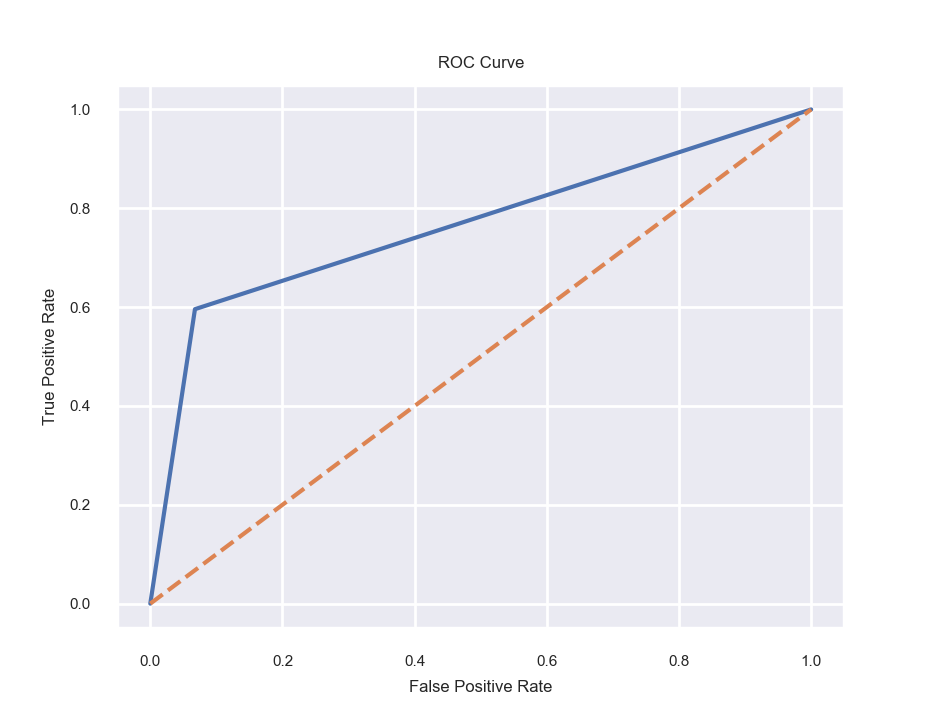

In [14]:
#eval_mod(nn_mod, trainX, trainY, testX, testY)
hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

In [13]:
# plot training and validation loss    
def plot_loss(hist):
    losses = hist.history
    plt.plot(losses['loss'], label='Training loss')
    plt.plot(losses['val_loss'], label='Validation loss')
    plt.legend()
    plt.show()

<IPython.core.display.Javascript object>


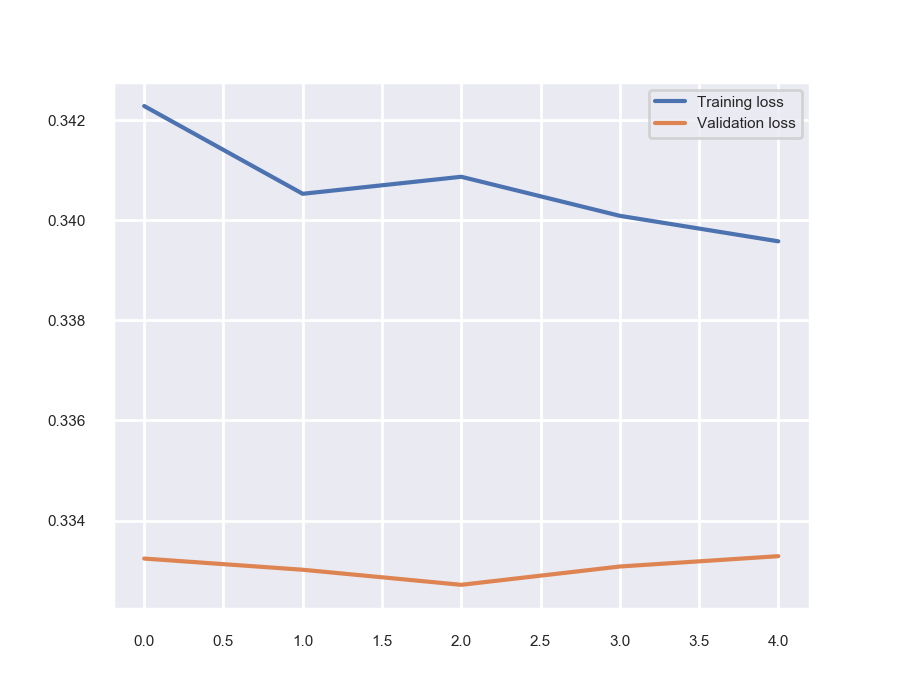

In [15]:
plot_loss(hist)

Train on 148944 samples, validate on 37236 samples
Epoch 1/50
148944/148944 [==============================] - 5s 32us/step - loss: 0.3353 - acc: 0.8432 - val_loss: 0.3314 - val_acc: 0.8469
Epoch 2/50
148944/148944 [==============================] - 5s 31us/step - loss: 0.3343 - acc: 0.8441 - val_loss: 0.3308 - val_acc: 0.8475
Epoch 3/50
148944/148944 [==============================] - 5s 35us/step - loss: 0.3342 - acc: 0.8444 - val_loss: 0.3309 - val_acc: 0.8476
Epoch 4/50
148944/148944 [==============================] - 4s 29us/step - loss: 0.3345 - acc: 0.8439 - val_loss: 0.3314 - val_acc: 0.8464
Epoch 5/50
148944/148944 [==============================] - 4s 29us/step - loss: 0.3348 - acc: 0.8441 - val_loss: 0.3312 - val_acc: 0.8469
Epoch 6/50
148944/148944 [==============================] - 5s 32us/step - loss: 0.3345 - acc: 0.8439 - val_loss: 0.3314 - val_acc: 0.8469
Epoch 7/50
148944/148944 [==============================] - 5s 32us/step - loss: 0.3342 - acc: 0.8440 - val_loss: 0

<IPython.core.display.Javascript object>


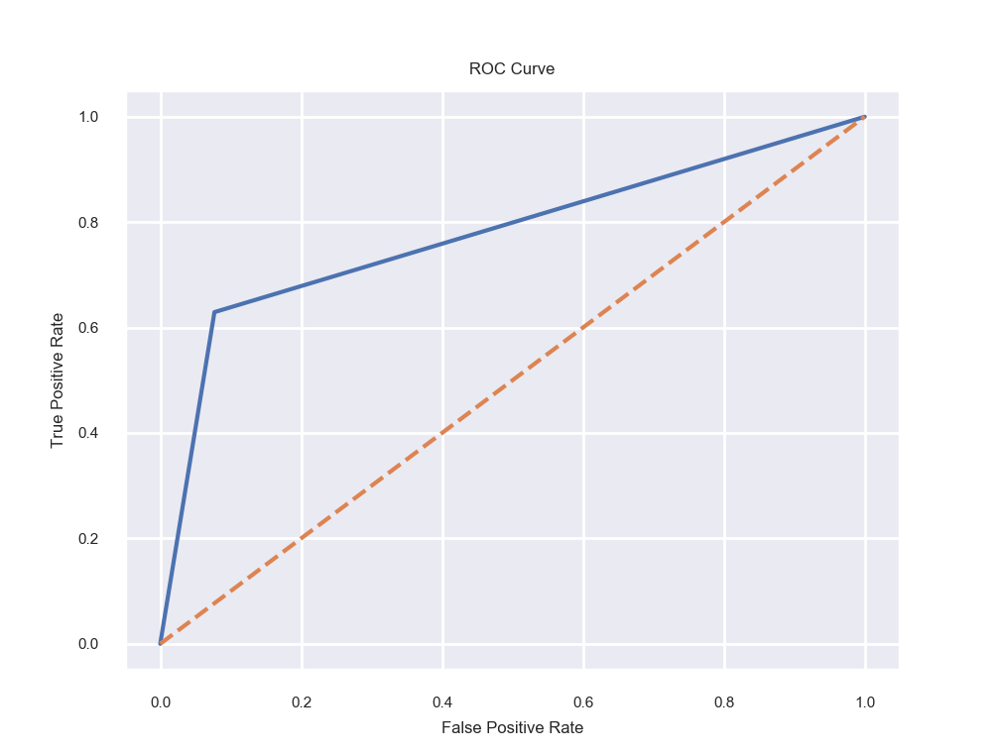

In [114]:
# increase epochs (experiment with epochs, batch size)
hist = nn_mod.fit(trainX_scale, trainY, epochs=50, batch_size=256, validation_split=0.2)
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

<IPython.core.display.Javascript object>


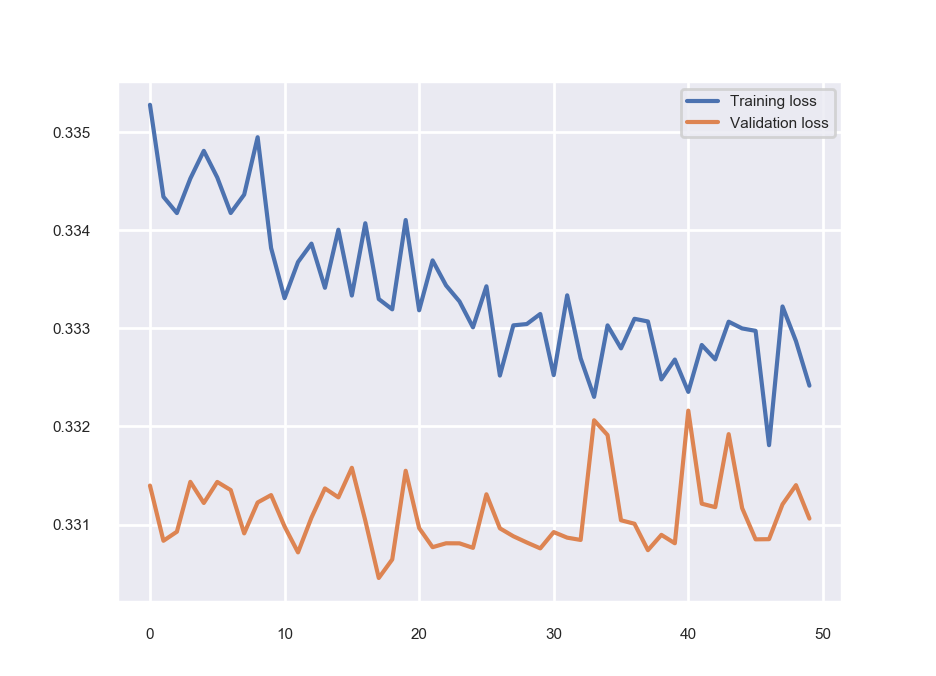

In [115]:
plot_loss(hist)

In [116]:
# reduce batch size
hist = nn_mod.fit(trainX_scale, trainY, epochs=10, batch_size=100, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

Train on 148944 samples, validate on 37236 samples
Epoch 1/10
148944/148944 [==============================] - 8s 56us/step - loss: 0.3339 - acc: 0.8450 - val_loss: 0.3313 - val_acc: 0.8482
Epoch 2/10
148944/148944 [==============================] - 10s 64us/step - loss: 0.3338 - acc: 0.8444 - val_loss: 0.3312 - val_acc: 0.8471
Epoch 3/10
148944/148944 [==============================] - 9s 60us/step - loss: 0.3334 - acc: 0.8448 - val_loss: 0.3311 - val_acc: 0.8479
Epoch 4/10
148944/148944 [==============================] - 9s 61us/step - loss: 0.3338 - acc: 0.8444 - val_loss: 0.3320 - val_acc: 0.8461
Epoch 5/10
148944/148944 [==============================] - 9s 62us/step - loss: 0.3335 - acc: 0.8453 - val_loss: 0.3321 - val_acc: 0.8468
Epoch 6/10
148944/148944 [==============================] - 8s 57us/step - loss: 0.3335 - acc: 0.8445 - val_loss: 0.3312 - val_acc: 0.8474
Epoch 7/10
148944/148944 [==============================] - 9s 62us/step - loss: 0.3332 - acc: 0.8455 - val_loss: 

In [117]:
# without Dropout
nn_mod = Sequential()
# hidden layer 1
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
nn_mod.add(Dense(25, activation='relu'))
nn_mod.add(Dense(10, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 40)                1640      
_________________________________________________________________
dense_10 (Dense)             (None, 25)                1025      
_________________________________________________________________
dense_11 (Dense)             (None, 10)                260       
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 11        
Total params: 2,936
Trainable params: 2,936
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 6s 39us/step - loss: 0.3547 - acc: 0.8326 - val_loss: 0.3343 - val_acc: 0.8452
Epoch 2/5
148944/148944 [==============================] - 3s 18us/step - loss: 0.3

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 128)               5248      
_________________________________________________________________
dropout_7 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_14 (Dense)             (None, 25)                3225      
_________________________________________________________________
dropout_8 (Dropout)          (None, 25)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 10)                260       
_________________________________________________________________
dropout_9 (Dropout)          (None, 10)                0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 11        
Total para

<IPython.core.display.Javascript object>


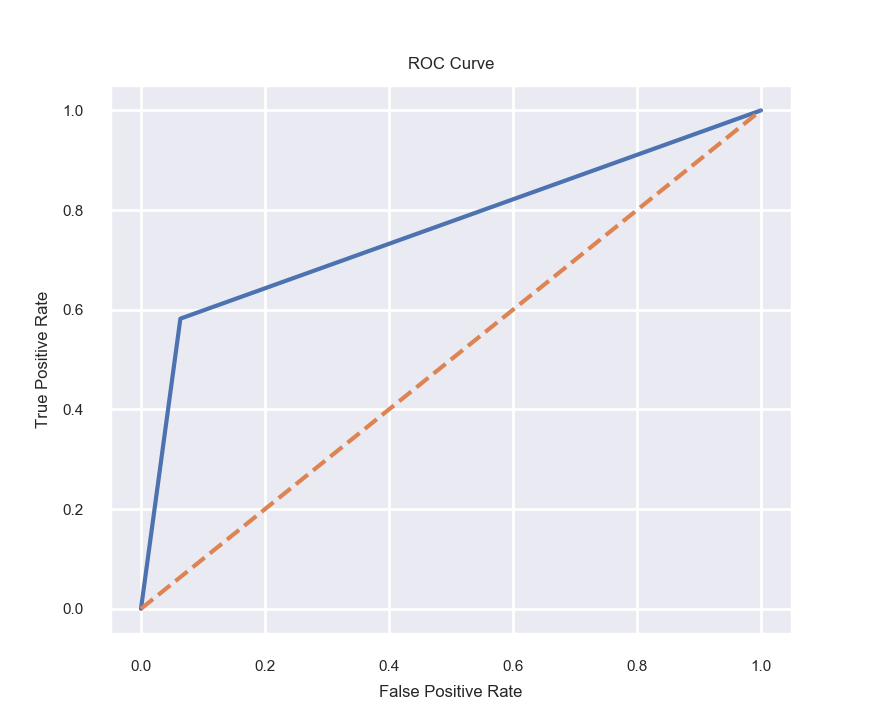

In [118]:
# increase neurons and Dropout(increased)
nn_mod = Sequential()
nn_mod.add(Dense(128, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(25, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.5))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_17 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_18 (Dense)             (None, 10)                210       
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 11        
Total params: 1,041
Trainable params: 1,041
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 5s 36us/step - loss: 0.3569 - acc: 0.8328 - val_loss: 0.3368 - val_acc: 0.8448
Epoch 2/5
148944/148944 [==============================] - 3s 19us/step - loss: 0.3325 - acc: 0.8452 - val_loss: 0.3347 - val_acc: 0.8460
Epoch 3/5
148944/148944 [==============================] - 2s 16us/step - los

<IPython.core.display.Javascript object>


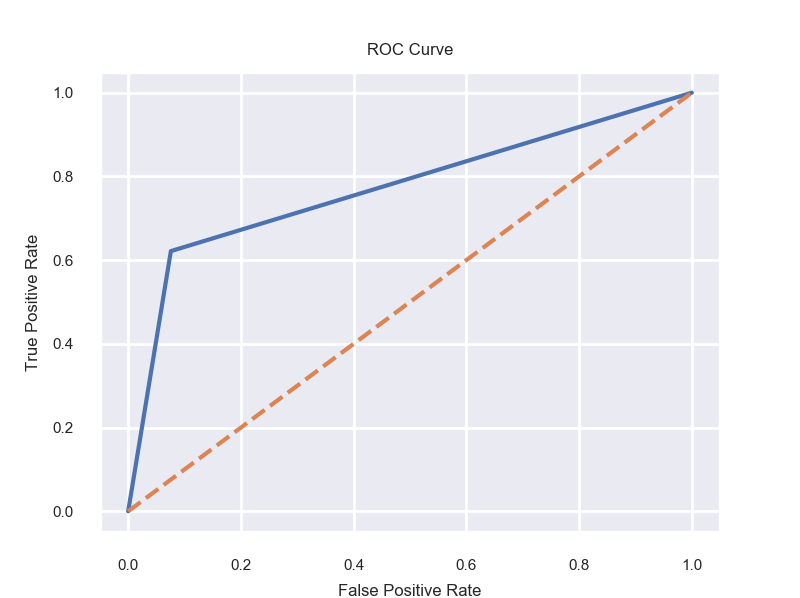

In [119]:
# really simple model (no Dropout)
nn_mod = Sequential()
nn_mod.add(Dense(20, input_dim=40, activation='relu'))
nn_mod.add(Dense(10, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

In [16]:
# simple with Dropout raised
nn_mod = Sequential()
nn_mod.add(Dense(20, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.5))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 20)                820       
_________________________________________________________________
dropout_7 (Dropout)          (None, 20)                0         
_________________________________________________________________
dense_10 (Dense)             (None, 10)                210       
_________________________________________________________________
dropout_8 (Dropout)          (None, 10)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 11        
Total params: 1,041
Trainable params: 1,041
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 5s 35us/step - loss: 0.4986 - 

In [17]:
# variation of simple/Dropout (different neuron size)
nn_mod = Sequential()
nn_mod.add(Dense(120, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.5))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, 120)               4920      
_________________________________________________________________
dropout_9 (Dropout)          (None, 120)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 10)                1210      
_________________________________________________________________
dropout_10 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 11        
Total params: 6,141
Trainable params: 6,141
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 7s 47us/step - loss: 0.4032 - 

In [18]:
# increase model hidden layers and size
nn_mod = Sequential()
nn_mod.add(Dense(150, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(50, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(20, activation='relu'))
nn_mod.add(Dropout(0.5))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_15 (Dense)             (None, 150)               6150      
_________________________________________________________________
dropout_11 (Dropout)         (None, 150)               0         
_________________________________________________________________
dense_16 (Dense)             (None, 50)                7550      
_________________________________________________________________
dropout_12 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_17 (Dense)             (None, 20)                1020      
_________________________________________________________________
dropout_13 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_18 (Dense)             (None, 1)                 21        
Total para

In [19]:
# increase layer and neurons again (variation)
nn_mod = Sequential()
nn_mod.add(Dense(200, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(100, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(50, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(20, activation='relu'))
nn_mod.add(Dropout(0.5))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_19 (Dense)             (None, 200)               8200      
_________________________________________________________________
dropout_14 (Dropout)         (None, 200)               0         
_________________________________________________________________
dense_20 (Dense)             (None, 100)               20100     
_________________________________________________________________
dropout_15 (Dropout)         (None, 100)               0         
_________________________________________________________________
dense_21 (Dense)             (None, 50)                5050      
_________________________________________________________________
dropout_16 (Dropout)         (None, 50)                0         
_________________________________________________________________
dense_22 (Dense)             (None, 20)                1020      
__________

In [27]:
# include weight decay along with Dropout (lowered), simpler network
from keras.regularizers import l2

nn_mod = Sequential()
# hidden layer 1
nn_mod.add(Dense(25, kernel_regularizer=l2(0.01), bias_regularizer=l2(0.01),input_dim=40, activation='relu'))
# add dropout for regularization 
nn_mod.add(Dropout(0.2))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.2))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_38 (Dense)             (None, 25)                1025      
_________________________________________________________________
dropout_28 (Dropout)         (None, 25)                0         
_________________________________________________________________
dense_39 (Dense)             (None, 10)                260       
_________________________________________________________________
dropout_29 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_40 (Dense)             (None, 1)                 11        
Total params: 1,296
Trainable params: 1,296
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 6s 40us/step - loss: 0.4935 - 

In [41]:
# network with f-score subset
features = ['Pop', 'loudness', 'Rap', 'Rock', 'acousticness', 'danceability',
           'instrumentalness']

nn_mod = Sequential()
# hidden layer 1
nn_mod.add(Dense(40, input_dim=trainX_scale[features].shape[1], activation='relu'))
nn_mod.add(Dense(10, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale[features], trainY, epochs=5, batch_size=100, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale[features])
nn_te_preds = nn_mod.predict_classes(testX_scale[features])
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_54 (Dense)             (None, 40)                320       
_________________________________________________________________
dense_55 (Dense)             (None, 10)                410       
_________________________________________________________________
dense_56 (Dense)             (None, 1)                 11        
Total params: 741
Trainable params: 741
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 7s 50us/step - loss: 0.4248 - acc: 0.8266 - val_loss: 0.4206 - val_acc: 0.8259
Epoch 2/5
148944/148944 [==============================] - 5s 35us/step - loss: 0.4192 - acc: 0.8280 - val_loss: 0.4203 - val_acc: 0.8259
Epoch 3/5
148944/148944 [==============================] - 5s 34us/step - loss: 0

In [46]:
# another network variation - Dropout lowered, simpler
nn_mod = Sequential()
# hidden layer 1
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
# add dropout for regularization 
nn_mod.add(Dropout(0.2))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dropout(0.2))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary() 

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_66 (Dense)             (None, 40)                1640      
_________________________________________________________________
dropout_41 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_67 (Dense)             (None, 10)                410       
_________________________________________________________________
dropout_42 (Dropout)         (None, 10)                0         
_________________________________________________________________
dense_68 (Dense)             (None, 1)                 11        
Total params: 2,061
Trainable params: 2,061
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 8s 54us/step - loss: 0.4005 - 

In [47]:
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

Test Cross-entropy loss:  5.25227648173499
AUC: 0.7597311622627152


###### *Best Neural Network model:* 

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_69 (Dense)             (None, 40)                1640      
_________________________________________________________________
dense_70 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_71 (Dense)             (None, 1)                 21        
Total params: 2,481
Trainable params: 2,481
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 6s 38us/step - loss: 0.3600 - acc: 0.8293 - val_loss: 0.3343 - val_acc: 0.8442
Epoch 2/5
148944/148944 [==============================] - 2s 17us/step - loss: 0.3313 - acc: 0.8456 - val_loss: 0.3329 - val_acc: 0.8471
Epoch 3/5
148944/148944 [==============================] - 2s 17us/step - los

<IPython.core.display.Javascript object>


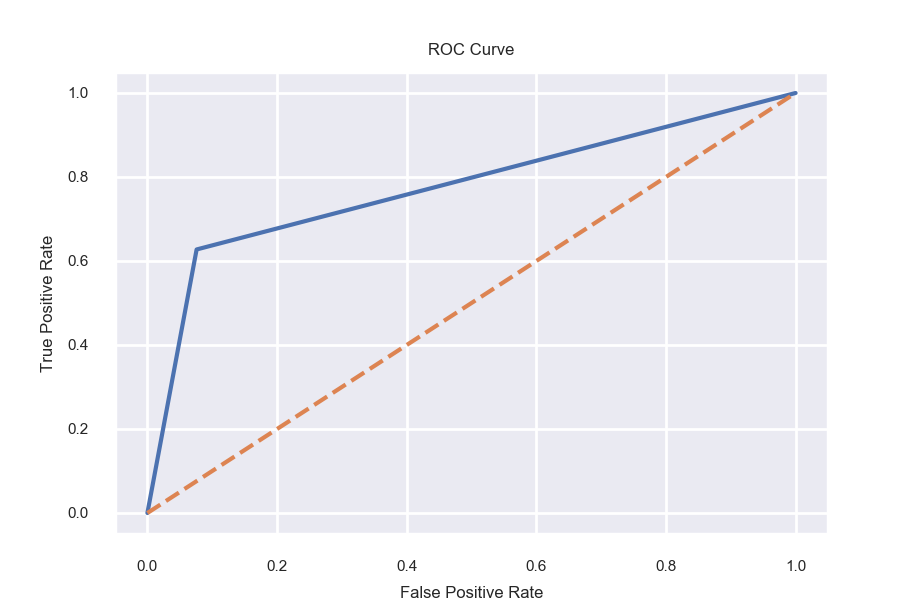

In [48]:
# neural network - simple with no Dropout - BEST NEURAL NETWORK (comparable results)
nn_mod = Sequential()
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
nn_mod.add(Dense(20, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

<IPython.core.display.Javascript object>


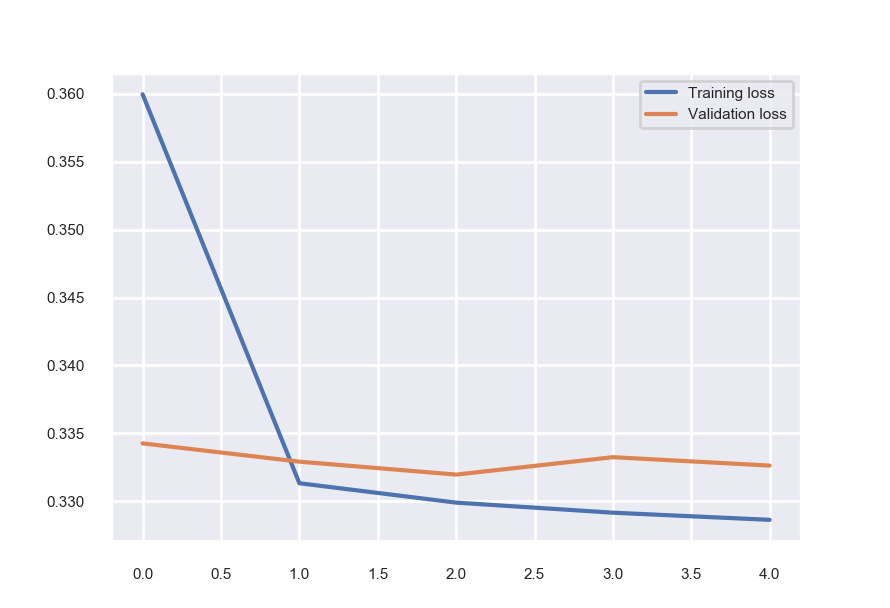

In [49]:
plot_loss(hist)

In [72]:
# cross validate best model
from keras.wrappers.scikit_learn import KerasClassifier

np.random.seed(7)

def create_cv_model():
    nn_cv_mod = Sequential()
    nn_cv_mod.add(Dense(40, input_dim=40, activation='relu'))
    nn_cv_mod.add(Dense(20, activation='relu'))
    nn_cv_mod.add(Dense(1, activation='sigmoid'))
    nn_cv_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
    return nn_cv_mod

nn_cv_mod = KerasClassifier(build_fn=create_cv_model, epochs=10, 
                                 batch_size=100, verbose=0)

nn_val_scores =cross_val_score(nn_cv_mod, trainX_scale, trainY,
                                      scoring='accuracy', cv=5)

print('Average validation accuracy:', nn_val_scores.mean())

Average validation accuracy: 0.8464013320442583


<IPython.core.display.Javascript object>


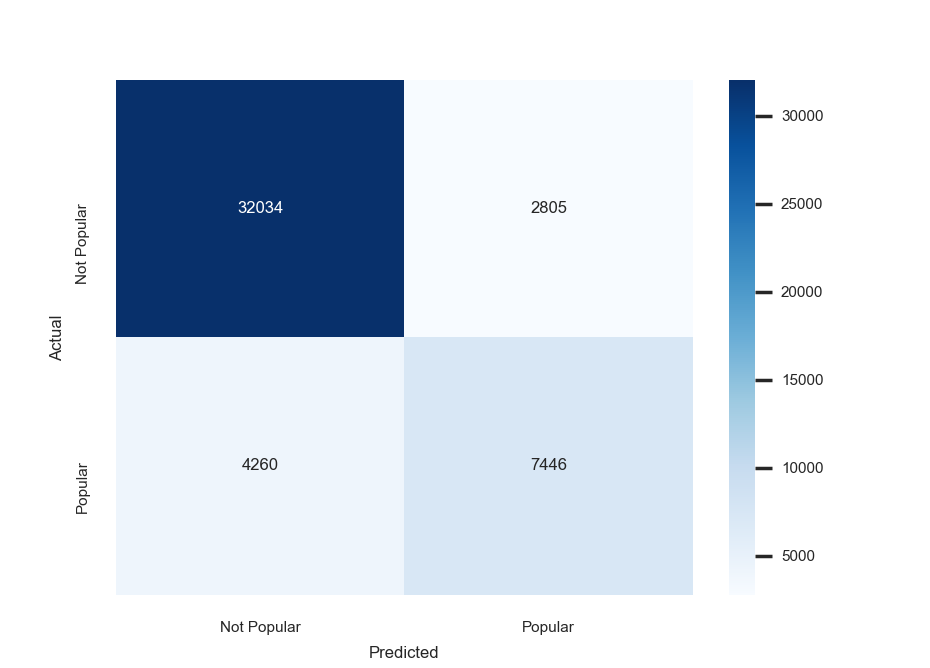

In [129]:
# print nice confusion matrix for 'best' model
cm_nn = metrics.confusion_matrix(testY, nn_te_preds, labels=[0,1])
#classes = [0,1] 
classes = ['Not Popular', 'Popular']
sns.heatmap(pd.DataFrame(cm_nn, index=classes, columns=classes),
annot=True, cmap='Blues', fmt='d') 
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [88]:
# append top scores table
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
name = 'Neural Network'
val_acc = nn_val_scores.mean()
test_acc = metrics.accuracy_score(testY, nn_te_preds)
test_auc = roc_auc_score(testY, nn_te_preds)
test_prec = metrics.precision_score(testY, nn_te_preds)
test_rec = metrics.recall_score(testY, nn_te_preds)

top_models = top_models.append({'Model': name, 'Validation Accuracy': val_acc, 
                                'Test Accuracy': test_acc, 'Test AUC': test_auc, 
                                'Test Precision': test_prec,'Test Recall': test_rec},
                               ignore_index=True)

In [138]:
top_models

,Model,Validation Accuracy,Test Accuracy,Test AUC,Test Precision,Test Recall
0,Logistic,0.844060,0.847159,0.758676,0.755054,0.580642
1,Random Forest,0.913884,0.919841,0.859810,0.927522,0.739023
2,Neural Network,0.846401,0.848211,0.777785,0.726368,0.636084


In [56]:
# alter best model with batch size
nn_mod = Sequential()
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.2))
nn_mod.add(Dense(20, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=32, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_78 (Dense)             (None, 40)                1640      
_________________________________________________________________
dropout_44 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_79 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_80 (Dense)             (None, 1)                 21        
Total params: 2,481
Trainable params: 2,481
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 24s 159us/step - loss: 0.3436 - acc: 0.8396 - val_loss: 0.3344 - val_acc: 0.8450
Epoch 2/5
148944/148944 [==============================] - 20s 131us/step - loss:

In [66]:
# rerun best model (see variation in metrics each run)
nn_mod = Sequential()
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
nn_mod.add(Dropout(0.5))
nn_mod.add(Dense(20, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_108 (Dense)            (None, 40)                1640      
_________________________________________________________________
dropout_46 (Dropout)         (None, 40)                0         
_________________________________________________________________
dense_109 (Dense)            (None, 20)                820       
_________________________________________________________________
dense_110 (Dense)            (None, 1)                 21        
Total params: 2,481
Trainable params: 2,481
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/5
148944/148944 [==============================] - 9s 57us/step - loss: 0.3990 - acc: 0.8136 - val_loss: 0.3361 - val_acc: 0.8440
Epoch 2/5
148944/148944 [==============================] - 4s 26us/step - loss: 0.3

In [59]:
# adjust learning rate (default: 0.001) on best model
from keras import optimizers

nn_mod = Sequential()
nn_mod.add(Dense(40, input_dim=40, activation='relu'))
nn_mod.add(Dense(20, activation='relu'))
# output
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer=optimizers.Adam(lr=0.0001),metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=10, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_87 (Dense)             (None, 40)                1640      
_________________________________________________________________
dense_88 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_89 (Dense)             (None, 1)                 21        
Total params: 2,481
Trainable params: 2,481
Non-trainable params: 0
_________________________________________________________________
Train on 148944 samples, validate on 37236 samples
Epoch 1/10
148944/148944 [==============================] - 7s 44us/step - loss: 0.4584 - acc: 0.7857 - val_loss: 0.3721 - val_acc: 0.8335
Epoch 2/10
148944/148944 [==============================] - 3s 21us/step - loss: 0.3502 - acc: 0.8412 - val_loss: 0.3435 - val_acc: 0.8414
Epoch 3/10
148944/148944 [==============================] - 3s 17us/step - 

In [62]:
# try another model iteration (more layers, fewer neurons), no Dropout 
nn_mod = Sequential()
nn_mod.add(Dense(20, input_dim=40, activation='relu'))
nn_mod.add(Dense(20, activation='relu'))
nn_mod.add(Dense(20, activation='relu'))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dense(10, activation='relu'))
nn_mod.add(Dense(1, activation='sigmoid'))

# add optimizer, compile, loss, metrics
nn_mod.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
nn_mod.summary()

hist = nn_mod.fit(trainX_scale, trainY, epochs=5, batch_size=256, validation_split=0.2)
nn_tr_preds = nn_mod.predict_classes(trainX_scale)
nn_te_preds = nn_mod.predict_classes(testX_scale)
    
# print metrics
print('Training Accuracy: ', str(metrics.accuracy_score(trainY, nn_tr_preds)))
print('Test Accuracy: ', str(metrics.accuracy_score(testY, nn_te_preds)))
print("Test Error: ", 1-metrics.accuracy_score(testY, nn_te_preds))
print('Test Cross-entropy loss: ', metrics.log_loss(testY, nn_te_preds))
print("AUC: " + str(roc_auc_score(testY, nn_te_preds)))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_99 (Dense)             (None, 20)                820       
_________________________________________________________________
dense_100 (Dense)            (None, 20)                420       
_________________________________________________________________
dense_101 (Dense)            (None, 20)                420       
_________________________________________________________________
dense_102 (Dense)            (None, 10)                210       
_________________________________________________________________
dense_103 (Dense)            (None, 10)                110       
_________________________________________________________________
dense_104 (Dense)            (None, 1)                 11        
Total params: 1,991
Trainable params: 1,991
Non-trainable params: 0
_________________________________________________________________
Train on

<IPython.core.display.Javascript object>


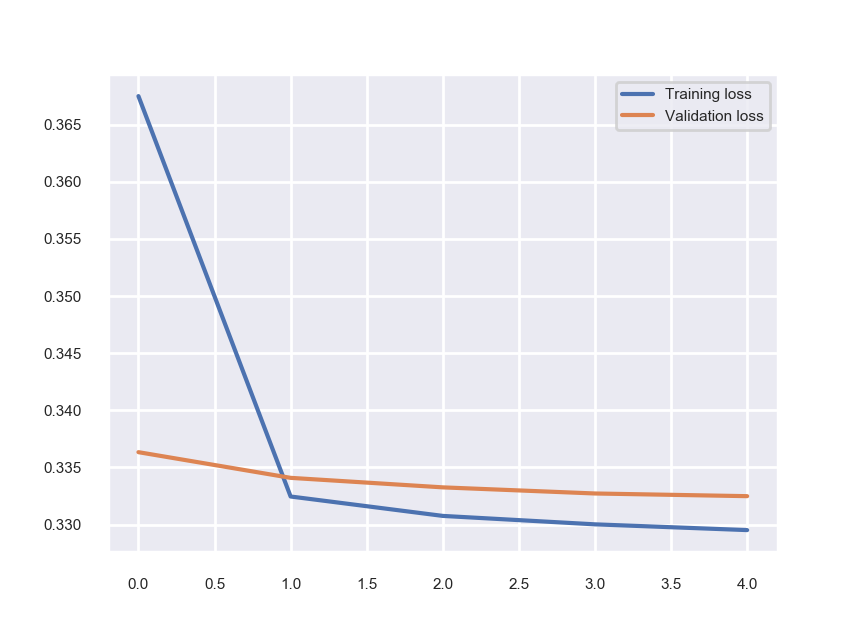

In [63]:
plot_loss(hist)

46545/46545 [==============================] - 2s 45us/step
Training Metrics - 
 Cross-entropy loss:  0.3291465316042632
 Accuracy:  0.8467021162316039 	Error: 0.15329788376839615
Testing Metrics - 
 Cross-entropy loss:  0.32784139459736816
 Accuracy:  0.8488129766930672 	Error: 0.1511870233069328
 Precision:  0.7210910124064779
 Recall:  0.6504356740133265
Confusion Matrix:
[[31894  2945]
 [ 4092  7614]]
AUC: 0.7829519855183885


<IPython.core.display.Javascript object>


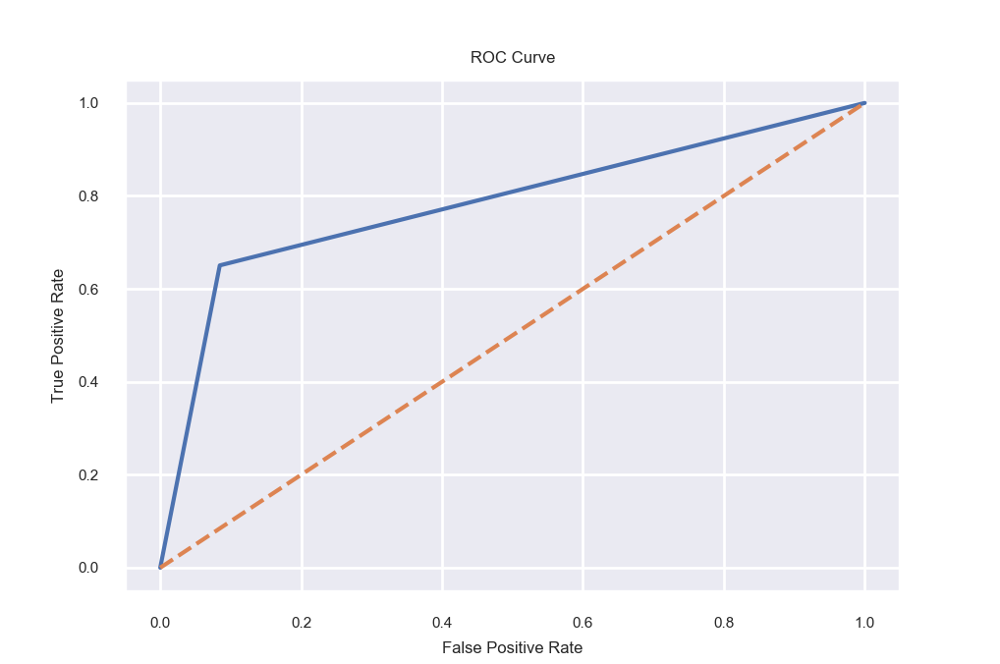

In [64]:
eval_mod(nn_mod, trainX_scale, trainY, testX_scale, testY)

### Visualize Metrics

In [90]:
top_models

,Model,Validation Accuracy,Test Accuracy,Test AUC,Test Precision,Test Recall
0,Logistic,0.844060,0.847159,0.758676,0.755054,0.580642
1,Random Forest,0.913884,0.919841,0.859810,0.927522,0.739023
2,Neural Network,0.846401,0.848211,0.777785,0.726368,0.636084


<IPython.core.display.Javascript object>


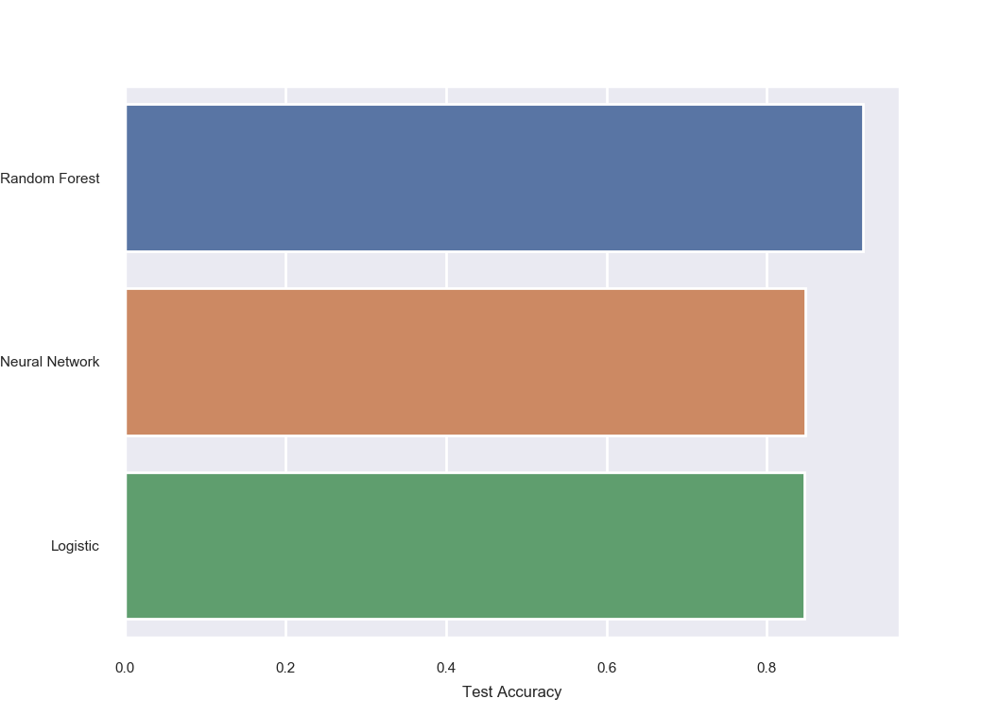

,Model,Test Accuracy
1,Random Forest,0.919841
2,Neural Network,0.848211
0,Logistic,0.847159


In [103]:
# sort by test accuracy
test_sort = top_models[['Model', 'Test Accuracy']].sort_values(by = "Test Accuracy", 
                                                               ascending = False)
sns.barplot(x='Test Accuracy', y='Model', data=test_sort)
plt.show()

test_sort

In [93]:
# sort by AUC
top_models[['Model', 'Test AUC']].sort_values(by = "Test AUC", ascending = False)

,Model,Test AUC
1,Random Forest,0.859810
2,Neural Network,0.777785
0,Logistic,0.758676


<IPython.core.display.Javascript object>


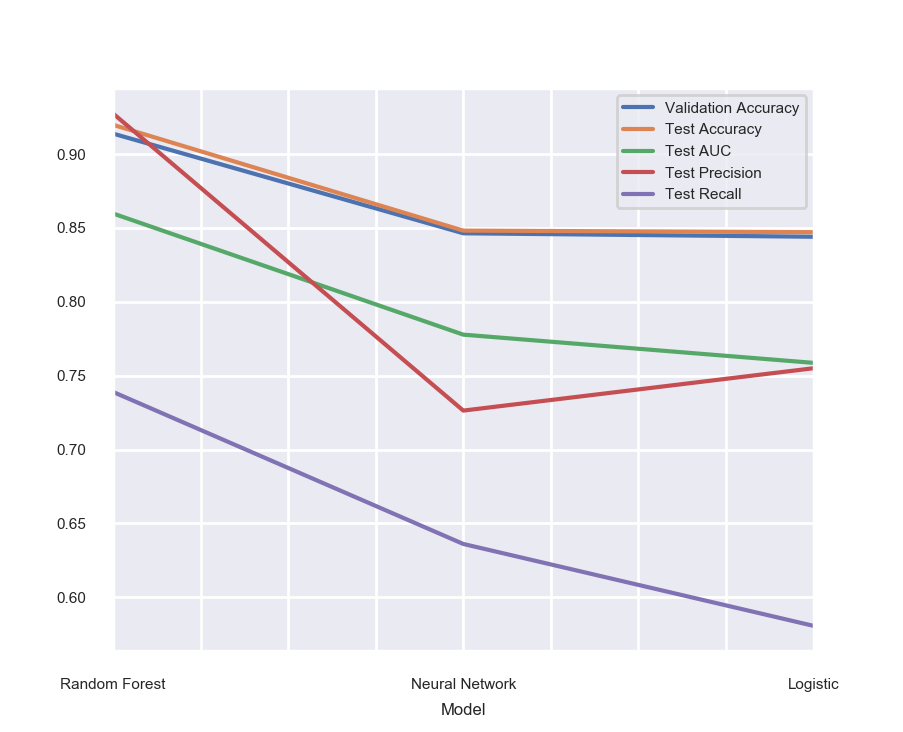

In [112]:
# plot all metrics
top_models.set_index('Model').sort_values(by = "Test Accuracy", 
                                          ascending = False).plot.line()
plt.show()

### Other Models

Included single decision tree in final report (thought would be good to see against random forest results)

In [12]:
# single simple decision tree
from sklearn.tree import DecisionTreeClassifier

dt_mod = DecisionTreeClassifier()
dt_mod.fit(trainX, trainY)

dt_tr_preds = dt_mod.predict(trainX)
dt_te_preds = dt_mod.predict(testX)

# print metrics
print('Train Accuracy:', metrics.accuracy_score(trainY, dt_tr_preds))
print("Test Accuracy: " , metrics.accuracy_score(testY, dt_te_preds))
print("Test Error: " , 1-metrics.accuracy_score(testY, dt_te_preds))
print('Test Precision: ',metrics.precision_score(testY, dt_te_preds))
print('Test Recall: ', metrics.recall_score(testY, dt_te_preds))
print("AUC: " + str(roc_auc_score(testY, dt_te_preds)))

Train Accuracy: 0.9996884735202493
Test Accuracy:  0.7892577075948007
Test Error:  0.21074229240519926
Test Precision:  0.5792066805845512
Test Recall:  0.592516658124039
AUC: 0.723939950233695


<IPython.core.display.Javascript object>


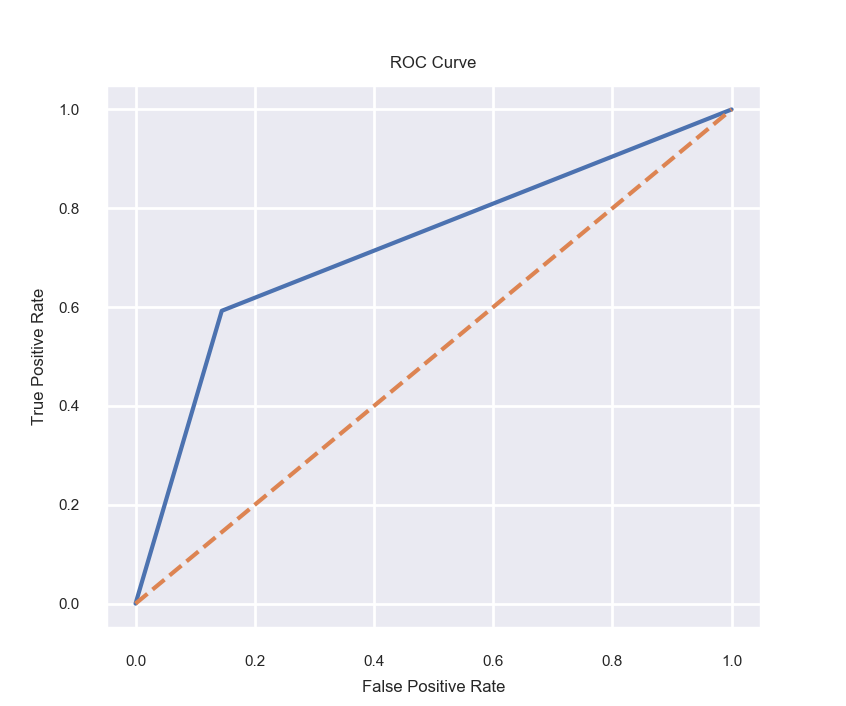

In [13]:
# ROC curve
fpr, tpr, _ = metrics.roc_curve(testY, dt_te_preds)
plt.plot(fpr, tpr)
plt.plot([0,1], [0,1], linestyle='--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()

<IPython.core.display.Javascript object>


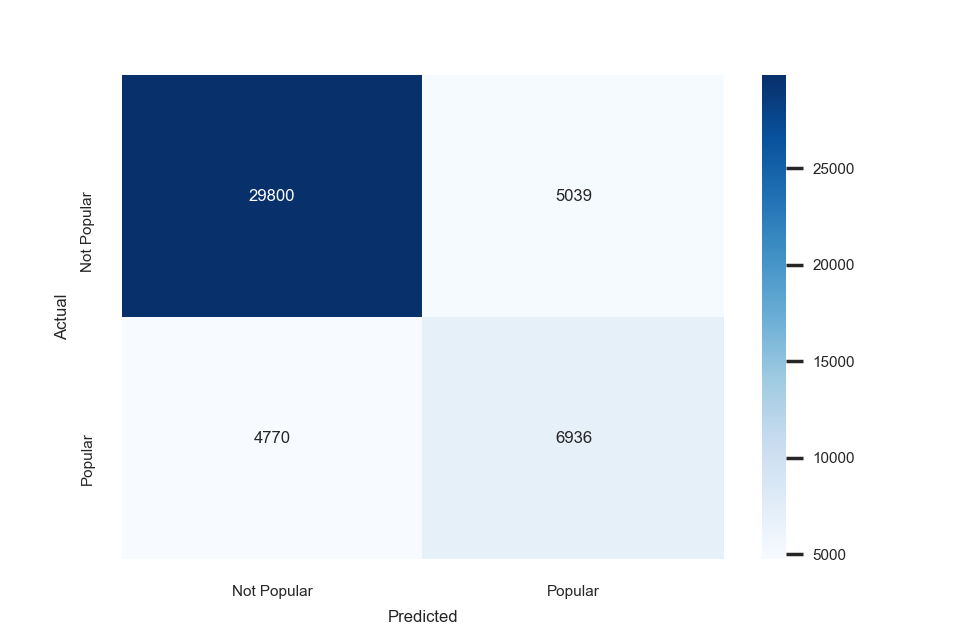

In [14]:
# print confusion matrix for DT
cm_dt = metrics.confusion_matrix(testY, dt_te_preds, labels=[0,1])
#classes = [0,1] 
classes = ['Not Popular', 'Popular']
sns.heatmap(pd.DataFrame(cm_dt, index=classes, columns=classes),
annot=True, cmap='Blues', fmt='d') 
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [15]:
# look at validation performance
dt_val_scores = cross_val_score(dt_mod, trainX, trainY, scoring='accuracy', cv=5)
print('Average validation accuracy:', dt_val_scores.mean())

Average validation accuracy: 0.785159511440838


In [22]:
# LDA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis 
lda_model = LinearDiscriminantAnalysis()
lda_model.fit(trainX, trainY)
tr_preds = lda_model.predict(trainX)
te_preds = lda_model.predict(testX)

print('Train Accuracy:', metrics.accuracy_score(trainY, tr_preds))
print("Test Accuracy: " , metrics.accuracy_score(testY, te_preds))
print("Test Error: " , 1-metrics.accuracy_score(testY, te_preds))
print("AUC: " + str(roc_auc_score(testY, te_preds)))

Train Accuracy: 0.8457514233537436
Test Accuracy:  0.8488559458588463
Test Error:  0.15114405414115373
AUC: 0.7775920217845025


/Users/suryamenon/miniconda3/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


In [147]:
# adaboost
from sklearn.ensemble import AdaBoostClassifier
ada_mod = AdaBoostClassifier(n_estimators=100, random_state=42)
ada_mod.fit(trainX, trainY)
tr_preds = ada_mod.predict(trainX)
te_preds = ada_mod.predict(testX)

print('Train Accuracy:', metrics.accuracy_score(trainY, tr_preds))
print("Test Accuracy: " , metrics.accuracy_score(testY, te_preds))
print("Test Error: " , 1-metrics.accuracy_score(testY, te_preds))
print("AUC: " + str(roc_auc_score(testY, te_preds)))

Train Accuracy: 0.846578579868944
Test Accuracy:  0.8482758620689655
Test Error:  0.15172413793103445
AUC: 0.7759566231361194


<IPython.core.display.Javascript object>


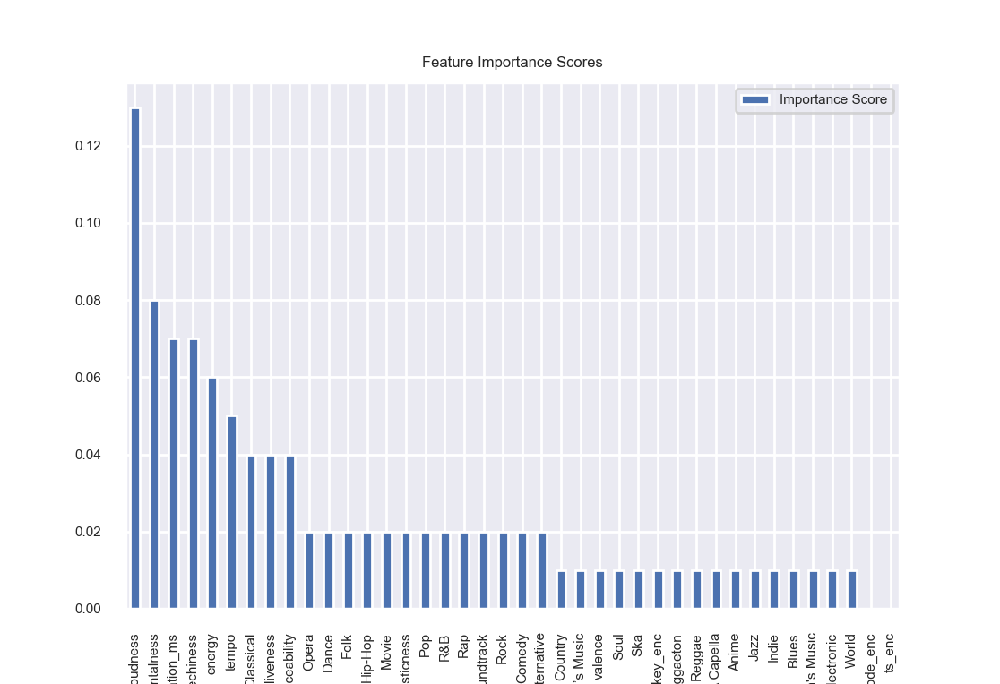

In [148]:
# adaboost importance
feature_scores = ada_mod.feature_importances_

features_df = pd.DataFrame({'Features': trainX.columns, 'Importance Score': feature_scores})
features_df.sort_values('Importance Score', inplace=True, ascending=False)

features_df.plot(x='Features',y='Importance Score',kind='bar')
plt.title('Feature Importance Scores')
plt.show()

In [106]:
# knn - best performance with k = 1
from sklearn.neighbors import KNeighborsClassifier

neighbors = list(range(1,10)) 
for n in neighbors:
    knn_model = KNeighborsClassifier(n_neighbors=n)
    knn_model.fit(trainX, trainY)
    print('\033[1mK:', n, '\033[0m')
    knn_tr_preds = knn_model.predict(trainX)
    print('Training Accuracy: ', metrics.accuracy_score(trainY, knn_tr_preds)) 
    knn_te_preds = knn_model.predict(testX)
    print('Testing Accuracy: ', metrics.accuracy_score(testY, knn_te_preds)) 
    print('Testing Error: ', 1-metrics.accuracy_score(testY, knn_te_preds))
    print("AUC: " + str(roc_auc_score(testY, knn_te_preds)), '\n')

K: 1 
Training Accuracy:  0.9996884735202493
Testing Accuracy:  0.8414007949296379
Testing Error:  0.15859920507036207
AUC: 0.822925105481554 

K: 2 
Training Accuracy:  0.9461435170265334
Testing Accuracy:  0.8039531636051134
Testing Error:  0.19604683639488663
AUC: 0.698162970179778 

K: 3 
Training Accuracy:  0.895799763669567
Testing Accuracy:  0.7679020302932645
Testing Error:  0.23209796970673546
AUC: 0.7098728582172876 

K: 4 
Training Accuracy:  0.8627940702545923
Testing Accuracy:  0.767816091954023
Testing Error:  0.232183908045977
AUC: 0.6397911391154528 

K: 5 
Training Accuracy:  0.8372220431840155
Testing Accuracy:  0.7453217316575357
Testing Error:  0.2546782683424643
AUC: 0.6518783798752434 

K: 6 
Training Accuracy:  0.8195509721774626
Testing Accuracy:  0.7550112794070255
Testing Error:  0.2449887205929745
AUC: 0.6079244307073871 

K: 7 
Training Accuracy:  0.8083951015146632
Testing Accuracy:  0.7415404447309055
Testing Error:  0.2584595552690945
AUC: 0.6212463213479

In [ ]:
# svm - didn't end up running - taking too much time to finish on full data
from sklearn import svm

# linear kernel
svm_model = svm.SVC(kernel='linear') 
svm_model.fit(trainX, trainY)

svm_tr_preds = svm_model.predict(trainX)
svm_te_preds = svm_model.predict(testX)

print('Train Accuracy:', metrics.accuracy_score(trainY, svm_tr_preds))
print("Test Accuracy: " , metrics.accuracy_score(testY, svm_te_preds))
print("Test Error: " , 1-metrics.accuracy_score(testY, svm_te_preds))
print("AUC: " + str(roc_auc_score(testY, svm_te_preds)))